In [1]:
%load_ext autoreload
%autoreload 2
import sys
sys.path.append("../../src")
import model.util as model_util
import model.mechint_net as mechint_net
import model.cnn as cnn
import model.explainn as explainn
import train.train_model as train_model
import analysis.motif_compare as motif_compare
import analysis.motif_util as motif_util
import feature.simulated_dataset as simulated_dataset
import feature.experimental_dataset as experimental_dataset
import plot.plot_motifs as plot_motifs
import os
import json
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as pcolors
import matplotlib.font_manager as font_manager
import tqdm.notebook
import pandas as pd

In [2]:
# Plotting defaults
font_files = font_manager.findSystemFonts(fontpaths="/home/tsenga5/lib/fonts")
for font_file in font_files:
    font_manager.fontManager.addfont(font_file)
    
plot_params = {
    "figure.titlesize": 22,
    "axes.titlesize": 22,
    "axes.labelsize": 20,
    "legend.fontsize": 18,
    "xtick.labelsize": 16,
    "ytick.labelsize": 16,
    "font.family": "Roboto",
    "font.weight": "bold",
    "svg.fonttype": "none"
}
plt.rcParams.update(plot_params)

In [3]:
if torch.cuda.is_available():
    DEVICE = "cuda"
else:
    DEVICE = "cpu"

### Define paths and constants

In [4]:
base_path = "/projects/site/gred/resbioai/tsenga5/mechint_regnet/"

In [5]:
datasets = [
    "SPI1", "TAL/GATA", "E2F6", "JUND/TEAD", "REST", "SPI1/CTCF",
    "CTCF (HepG2)", "FOXA1 (HepG2)", "DNase (HepG2)", "DNase (HL-60)", "DNase (K562)"
]

In [6]:
datasets_sanit = {
    dataset_key : dataset_key.replace("/", "_").replace(" ", "").replace("(", "_").replace(")", "").lower()
    for dataset_key in datasets
}

In [7]:
mechint_model_paths = {
    "SPI1": os.path.join(base_path, "models/trained_models/simulated/spi1_exp_single/mechint_net/2/last_ckpt.pth"),
    "TAL/GATA": os.path.join(base_path, "models/trained_models/simulated/tal_gata_exp_mix/mechint_net/2/last_ckpt.pth"),
    "E2F6": os.path.join(base_path, "models/trained_models/simulated/e2f6_max_exp_coop/mechint_net/2/last_ckpt.pth"),
    "JUND/TEAD": os.path.join(base_path, "models/trained_models/simulated/jund_tead_exp_hard_spacing/mechint_net/2/last_ckpt.pth"),
    "REST": os.path.join(base_path, "models/trained_models/simulated/rest_exp_both/mechint_net/2/last_ckpt.pth"),
    "SPI1/CTCF": os.path.join(base_path, "models/trained_models/simulated/spi1_ctcf_exp_repress/mechint_net/3/last_ckpt.pth"),
    "CTCF (HepG2)": os.path.join(base_path, "models/trained_models/experimental/chipseq_ctcf_hepg2/mechint_net/1/last_ckpt.pth"),
    "FOXA1 (HepG2)": os.path.join(base_path, "models/trained_models/experimental/chipseq_foxa1_hepg2/mechint_net/3/last_ckpt.pth"),
    "DNase (HepG2)": os.path.join(base_path, "models/trained_models/experimental/dnase_hepg2/mechint_net/3/last_ckpt.pth"),
    "DNase (HL-60)": os.path.join(base_path, "models/trained_models/experimental/dnase_hl60/mechint_net/3/last_ckpt.pth"),
    "DNase (K562)": os.path.join(base_path, "models/trained_models/experimental/dnase_k562/mechint_net/1/last_ckpt.pth")
}
cnn_model_paths = {
    "SPI1": os.path.join(base_path, "models/trained_models/simulated/spi1_exp_single/standard_cnn/1/last_ckpt.pth"),
    "TAL/GATA": os.path.join(base_path, "models/trained_models/simulated/tal_gata_exp_mix/standard_cnn/3/last_ckpt.pth"),
    "E2F6": os.path.join(base_path, "models/trained_models/simulated/e2f6_max_exp_coop/standard_cnn/1/last_ckpt.pth"),
    "JUND/TEAD": os.path.join(base_path, "models/trained_models/simulated/jund_tead_exp_hard_spacing/standard_cnn/2/last_ckpt.pth"),
    "REST": os.path.join(base_path, "models/trained_models/simulated/rest_exp_both/standard_cnn/1/last_ckpt.pth"),
    "SPI1/CTCF": os.path.join(base_path, "models/trained_models/simulated/spi1_ctcf_exp_repress/standard_cnn/1/last_ckpt.pth"),
    "CTCF (HepG2)": os.path.join(base_path, "models/trained_models/experimental/chipseq_ctcf_hepg2/standard_cnn/3/last_ckpt.pth"),
    "FOXA1 (HepG2)": os.path.join(base_path, "models/trained_models/experimental/chipseq_foxa1_hepg2/standard_cnn/3/last_ckpt.pth"),
    "DNase (HepG2)": os.path.join(base_path, "models/trained_models/experimental/dnase_hepg2/standard_cnn/2/last_ckpt.pth"),
    "DNase (HL-60)": os.path.join(base_path, "models/trained_models/experimental/dnase_hl60/standard_cnn/3/last_ckpt.pth"),
    "DNase (K562)": os.path.join(base_path, "models/trained_models/experimental/dnase_k562/standard_cnn/1/last_ckpt.pth")
}
explainn_model_paths = {
    "SPI1": os.path.join(base_path, "models/trained_models/simulated/spi1_exp_single/explainn/1/last_ckpt.pth"),
    "TAL/GATA": os.path.join(base_path, "models/trained_models/simulated/tal_gata_exp_mix/explainn/1/last_ckpt.pth"),
    "E2F6": os.path.join(base_path, "models/trained_models/simulated/e2f6_max_exp_coop/explainn/2/last_ckpt.pth"),
    "JUND/TEAD": os.path.join(base_path, "models/trained_models/simulated/jund_tead_exp_hard_spacing/explainn/3/last_ckpt.pth"),
    "REST": os.path.join(base_path, "models/trained_models/simulated/rest_exp_both/explainn/2/last_ckpt.pth"),
    "SPI1/CTCF": os.path.join(base_path, "models/trained_models/simulated/spi1_ctcf_exp_repress/explainn/1/last_ckpt.pth"),
    "CTCF (HepG2)": os.path.join(base_path, "models/trained_models/experimental/chipseq_ctcf_hepg2/explainn/2/last_ckpt.pth"),
    "FOXA1 (HepG2)": os.path.join(base_path, "models/trained_models/experimental/chipseq_foxa1_hepg2/explainn/1/last_ckpt.pth"),
    "DNase (HepG2)": os.path.join(base_path, "models/trained_models/experimental/dnase_hepg2/explainn/3/last_ckpt.pth"),
    "DNase (HL-60)": os.path.join(base_path, "models/trained_models/experimental/dnase_hl60/explainn/2/last_ckpt.pth"),
    "DNase (K562)": os.path.join(base_path, "models/trained_models/experimental/dnase_k562/explainn/3/last_ckpt.pth")
}

In [8]:
modisco_results_paths = {
    "SPI1": os.path.join(base_path, "results/impscore_modisco/simulated/spi1_exp_single/standard_cnn/shap_modisco_results.h5"),
    "TAL/GATA": os.path.join(base_path, "results/impscore_modisco/simulated/tal_gata_exp_mix/standard_cnn/shap_modisco_results.h5"),
    "E2F6": os.path.join(base_path, "results/impscore_modisco/simulated/e2f6_max_exp_coop/standard_cnn/shap_modisco_results.h5"),
    "JUND/TEAD": os.path.join(base_path, "results/impscore_modisco/simulated/jund_tead_exp_hard_spacing/standard_cnn/shap_modisco_results.h5"),
    "REST": os.path.join(base_path, "results/impscore_modisco/simulated/rest_exp_both/standard_cnn/shap_modisco_results.h5"),
    "SPI1/CTCF": os.path.join(base_path, "results/impscore_modisco/simulated/spi1_ctcf_exp_repress/standard_cnn/shap_modisco_results.h5"),
    "CTCF (HepG2)": os.path.join(base_path, "results/impscore_modisco/experimental/chipseq_ctcf_hepg2/standard_cnn/shap_modisco_results.h5"),
    "FOXA1 (HepG2)": os.path.join(base_path, "results/impscore_modisco/experimental/chipseq_foxa1_hepg2/standard_cnn/shap_modisco_results.h5"),
    "DNase (HepG2)": os.path.join(base_path, "results/impscore_modisco/experimental/dnase_hepg2/standard_cnn/shap_modisco_results.h5"),
    "DNase (HL-60)": os.path.join(base_path, "results/impscore_modisco/experimental/dnase_hl60/standard_cnn/shap_modisco_results.h5"),
    "DNase (K562)": os.path.join(base_path, "results/impscore_modisco/experimental/dnase_k562/standard_cnn/shap_modisco_results.h5")
}

In [9]:
sim_motif_config_paths = {
    "SPI1": [os.path.join(base_path, "data/simulations/configs/spi1_exp_single_config.json")],
    "TAL/GATA": [os.path.join(base_path, "data/simulations/configs/tal_gata_exp_mix_config.json")],
    "E2F6": [os.path.join(base_path, "data/simulations/configs/e2f6_max_exp_coop_config.json"), os.path.join(base_path, "data/simulations/configs/e2f6_max_exp_coop_neg_config.json")],
    "JUND/TEAD": [os.path.join(base_path, "data/simulations/configs/jund_tead_exp_hard_spacing_config.json")],
    "REST": [os.path.join(base_path, "data/simulations/configs/rest_exp_both_config.json"), os.path.join(base_path, "data/simulations/configs/rest_exp_both_neg_config.json")],
    "SPI1/CTCF": [os.path.join(base_path, "data/simulations/configs/spi1_ctcf_exp_repress_config.json"), os.path.join(base_path, "data/simulations/configs/spi1_ctcf_exp_repress_neg_config.json")],
}

In [10]:
exp_peak_bed_paths = {
    "CTCF (HepG2)": os.path.join(base_path, "data/encode/chipseq/ENCSR607XFI_CTCF_HepG2/ENCFF664UGR_idrpeaks.bed.gz"),
    "FOXA1 (HepG2)": os.path.join(base_path, "data/encode/chipseq/ENCSR865RXA_FOXA1_HepG2/ENCFF081USG_idrpeaks.bed.gz"),
    "DNase (HepG2)": os.path.join(base_path, "data/encode/dnase/ENCSR149XIL_HepG2/ENCFF897NME_peaks.bed.gz"),
    "DNase (HL-60)": os.path.join(base_path, "data/encode/dnase/ENCSR889WKL_HL60/ENCFF773SFA_peaks.bed.gz"),
    "DNase (K562)": os.path.join(base_path, "data/encode/dnase/ENCSR000EKS_K562/ENCFF274YGF_peaks.bed.gz")
}

In [11]:
known_motifs_path = "/home/tsenga5/mechint_regnet/data/databases/JASPAR2022_CORE_vertebrates_non-redundant_pfms_meme_sanitname.txt"

In [12]:
motifs_cache_path = "/home/tsenga5/mechint_regnet/results/motifs/"

In [13]:
figures_out_path = "/home/tsenga5/mechint_regnet/figures/"

### Import model motifs

In [14]:
def model_to_pfms(model, data_loader, max_thresh_frac=0.5):
    """
    Given a model and a data loader, runs through the input sequences
    in the data loader and collects convolutional activations from the
    entire epoch.
    Returns a F x W x 4 array of PFMs for the filters. If a filter is
    never activated, its PFM will be all 0.
    """
    _, _, _, _, model_outputs_other, input_data = \
        train_model.run_epoch(data_loader, "eval", model, epoch_num=0, return_extras=True)
    conv_acts = model_outputs_other["conv_acts"]  # Shape: N x L' x F
    input_seqs = input_data[0]  # Shape: N x L x 4
    num_filters = conv_acts.shape[2]
    filter_width = input_seqs.shape[1] - conv_acts.shape[1] + 1

    # Compute minimum activations needed
    act_threshes = np.max(conv_acts, axis=(0, 1)) * max_thresh_frac

    # Construct PFMs
    pfms = np.zeros((num_filters, filter_width, 4))
    for i in range(num_filters):
        if act_threshes[i] == 0:
            continue
        ex_inds, start_inds = np.where(conv_acts[:, :, i] > act_threshes[i])
        if not ex_inds.size:
            # Nothing passed the threshold
            continue
        # Trick to get all matching subsequences, where we flatten the set of all
        # indices we want and then reshape
        seqs = input_seqs[
            np.repeat(ex_inds, filter_width),
            (np.arange(filter_width)[None] + start_inds[:, None]).reshape(-1)
        ].reshape(len(ex_inds), filter_width, -1)
        pfms[i] = np.mean(seqs, axis=0)

    return pfms

In [15]:
# For each dataset, create a data loader and use it to compute PFMs and activation frequencies
mechint_pfms, cnn_pfms, explainn_pfms = {}, {}, {}
mechint_pfms_used, cnn_pfms_used, explainn_pfms_used = {}, {}, {}
for dataset_key in tqdm.notebook.tqdm(datasets):
    # Create dataloader
    if dataset_key in sim_motif_config_paths:
        data_loader = simulated_dataset.dataset_ex.run(
            "create_data_loader", config_updates={
                "motif_config_path": sim_motif_config_paths[dataset_key][0],  # Only the positive labels
                "input_length": 500,
                "motif_center_dist_bound": 50,
                "batch_size": 100,
                "num_batches": 100,  # 10K sequences
                "negative_ratio": 0,  # No negatives
                "background_match_reject_prob": 1,
                "neg_motif_config_path": None  # No negatives, so ignore this field
            }
        ).result
    else:
        data_loader = experimental_dataset.dataset_ex.run(
            "create_data_loader", config_updates={
                "peaks_bed_path": exp_peak_bed_paths[dataset_key],
                "batch_size": 128,
                "chrom_set": ["chr1"],  # Test set,
                "negative_ratio": 0  # No negatives
            }
        ).result
    data_loader.dataset.on_epoch_start()

    cache_dir = os.path.join(
        motifs_cache_path,
        dataset_key.replace("/", "-").replace(" ", "").replace("(", "_").replace(")", "").lower()
    )
    os.makedirs(cache_dir, exist_ok=True)

    mechint_pfms_path = os.path.join(cache_dir, "mechint_net.npz")
    if os.path.exists(mechint_pfms_path):
        mechint_pfms[dataset_key] = np.load(mechint_pfms_path)["pfms"]
    else:
        mechint_model = model_util.load_model(
            mechint_net.MechIntRegNet, mechint_model_paths[dataset_key]
        ).to(DEVICE)
        mechint_pfms[dataset_key] = model_to_pfms(mechint_model, data_loader)
        np.savez(mechint_pfms_path, pfms=mechint_pfms[dataset_key])
    mechint_pfms_used[dataset_key] = [np.sum(pfm) > 0 for pfm in mechint_pfms[dataset_key]]

    cnn_pfms_path = os.path.join(cache_dir, "standard_cnn.npz")
    if os.path.exists(cnn_pfms_path):
        cnn_pfms[dataset_key] = np.load(cnn_pfms_path)["pfms"]
    else:
        cnn_model = model_util.load_model(
            cnn.ConvNet, cnn_model_paths[dataset_key]
        ).to(DEVICE)
        cnn_pfms[dataset_key] = model_to_pfms(cnn_model, data_loader)
        np.savez(cnn_pfms_path, pfms=cnn_pfms[dataset_key])
    cnn_pfms_used[dataset_key] = [np.sum(pfm) > 0 for pfm in cnn_pfms[dataset_key]]

    explainn_pfms_path = os.path.join(cache_dir, "explainn.npz")
    if os.path.exists(explainn_pfms_path):
        explainn_pfms[dataset_key] = np.load(explainn_pfms_path)["pfms"]
    else:
        explainn_model = model_util.load_model(
            explainn.ExplaiNN, explainn_model_paths[dataset_key]
        ).to(DEVICE)
        explainn_pfms[dataset_key] = model_to_pfms(explainn_model, data_loader)
        np.savez(explainn_pfms_path, pfms=explainn_pfms[dataset_key])
    explainn_pfms_used[dataset_key] = [np.sum(pfm) > 0 for pfm in explainn_pfms[dataset_key]]

  0%|          | 0/11 [00:00<?, ?it/s]

WARNING - root - Added new config entry: "motif_config_path"
WARNING - root - Added new config entry: "neg_motif_config_path"
WARNING - sim_dataset - No observers have been added to this run
INFO - sim_dataset - Running command 'create_data_loader'
INFO - sim_dataset - Started
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 10 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
INFO - sim_dataset - Result: <torch.utils.data.dataloader.DataLoader object at 0x14e9d3663230>
INFO - sim_dataset - Completed after 0:00:00
WARNING - root - Added new config entry: "motif_config_path"
WARNING - root - A

### Import MoDISco motifs

In [16]:
modisco_pfms, modisco_num_seqlets = {}, {}
for dataset_key in datasets:
    pfms, _, _, num_seqlets = motif_util.import_modisco_motifs(modisco_results_paths[dataset_key])
    modisco_pfms[dataset_key] = pfms
    modisco_num_seqlets[dataset_key] = num_seqlets

In [17]:
# For a fair comparison, trim the MoDISco motifs to the same size as the filters
modisco_trimmed_pfms = {}
for dataset_key in datasets:
    trim_size = mechint_pfms[dataset_key].shape[1]
    modisco_trimmed_pfms[dataset_key] = [
        motif_util.trim_motif_by_max_ic_window(pfm, motif_util.pfm_info_content(pfm), trim_size)
        for pfm in modisco_pfms[dataset_key]
    ]

### Compute top motif matches

In [18]:
def extract_tomtom_matches(num_motifs, tomtom_matches):
    """
    Takes a dictionary of TOMTOM matches (keys are indices) and a maximum
    number of motifs, and returns a list of length `num_motifs`, where each
    entry is a list of tuples of the matches (each tuple is the matched motif
    key, whether or not the match is reverse-complemented, and the -log(q-value).
    """
    result = [None] * num_motifs
    for i in range(num_motifs):
        try:
            subtable = tomtom_matches[i]
            subtable = subtable.sort_values("q-value")
            subtable["RC"] = subtable["Orientation"] == "-"
            subtable["Score"] = -np.log10(subtable["q-value"])
            result[i] = [tuple(row) for row in subtable[["Target_ID", "RC", "Score"]].values]
        except KeyError:
            result[i] = []
    return result

In [19]:
# Compute similarities for each
mechint_sims, cnn_sims, explainn_sims, modisco_sims = {}, {}, {}, {}
true_pfms = {}
for dataset_key in tqdm.notebook.tqdm(datasets):
    # Import true motifs
    if dataset_key in sim_motif_config_paths:
        # Simulation
        true_pfms[dataset_key] = {}
        motif_files = []
        for config_path in sim_motif_config_paths[dataset_key]:
            with open(config_path, "r") as f:
                motif_config = json.load(f)
                motif_files.extend(motif_config["motif_files"])
        motif_files = list(set(motif_files))
        for motif_file in motif_files:
            true_pfms[dataset_key].update({
                key : val for key, val in motif_util.import_meme_motifs(motif_file).items()
                if key.endswith("_exp")
            })
    else:
        # Experimental
        true_pfms[dataset_key] = motif_util.import_meme_motifs(known_motifs_path)
        
    # Run TOMTOM to match each discovered motif to the true motifs
    mechint_subtables = motif_compare.run_tomtom(
        {i : pfm for i, pfm in enumerate(mechint_pfms[dataset_key]) if mechint_pfms_used[dataset_key][i]},
        true_pfms[dataset_key]
    )
    cnn_subtables = motif_compare.run_tomtom(
        {i : pfm for i, pfm in enumerate(cnn_pfms[dataset_key]) if cnn_pfms_used[dataset_key][i]},
        true_pfms[dataset_key]
    )
    explainn_subtables = motif_compare.run_tomtom(
        {i : pfm for i, pfm in enumerate(explainn_pfms[dataset_key]) if explainn_pfms_used[dataset_key][i]},
        true_pfms[dataset_key]
    )
    modisco_subtables = motif_compare.run_tomtom(dict(enumerate(modisco_pfms[dataset_key])), true_pfms[dataset_key])

    # Collect top matches for each motif
    mechint_sims[dataset_key] = extract_tomtom_matches(len(mechint_pfms[dataset_key]), mechint_subtables)
    cnn_sims[dataset_key] = extract_tomtom_matches(len(cnn_pfms[dataset_key]), cnn_subtables)
    explainn_sims[dataset_key] = extract_tomtom_matches(len(explainn_pfms[dataset_key]), explainn_subtables)
    modisco_sims[dataset_key] = extract_tomtom_matches(len(modisco_pfms[dataset_key]), modisco_subtables)

  0%|          | 0/11 [00:00<?, ?it/s]

### Plot motifs

SPI1


/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3

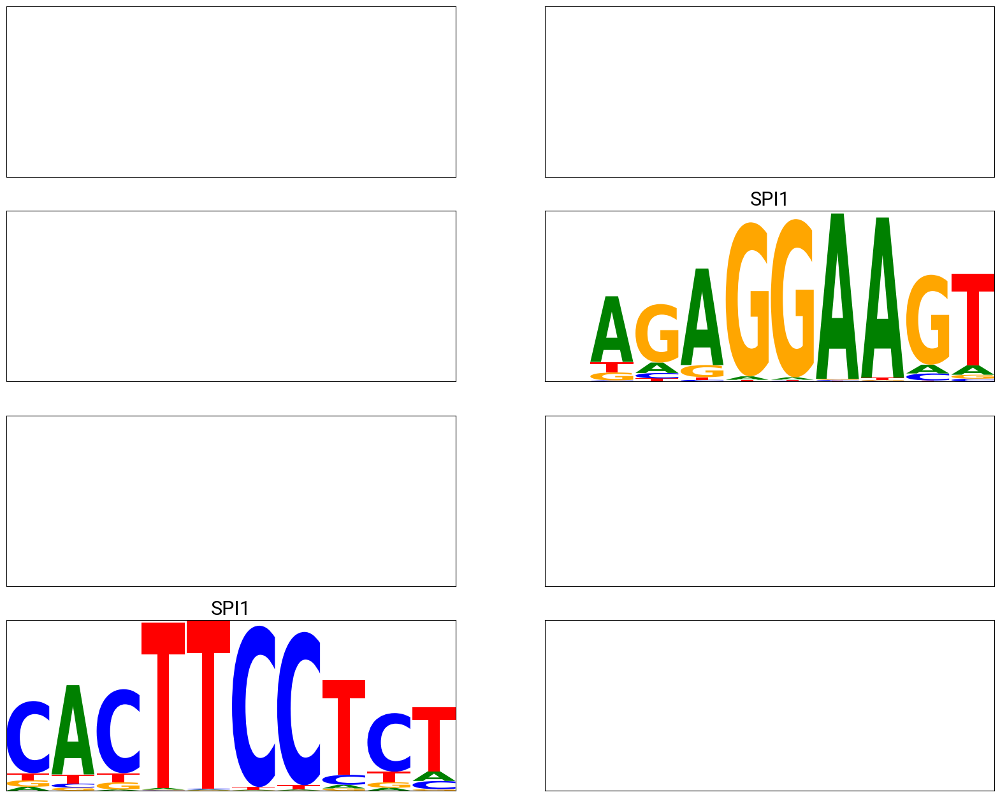

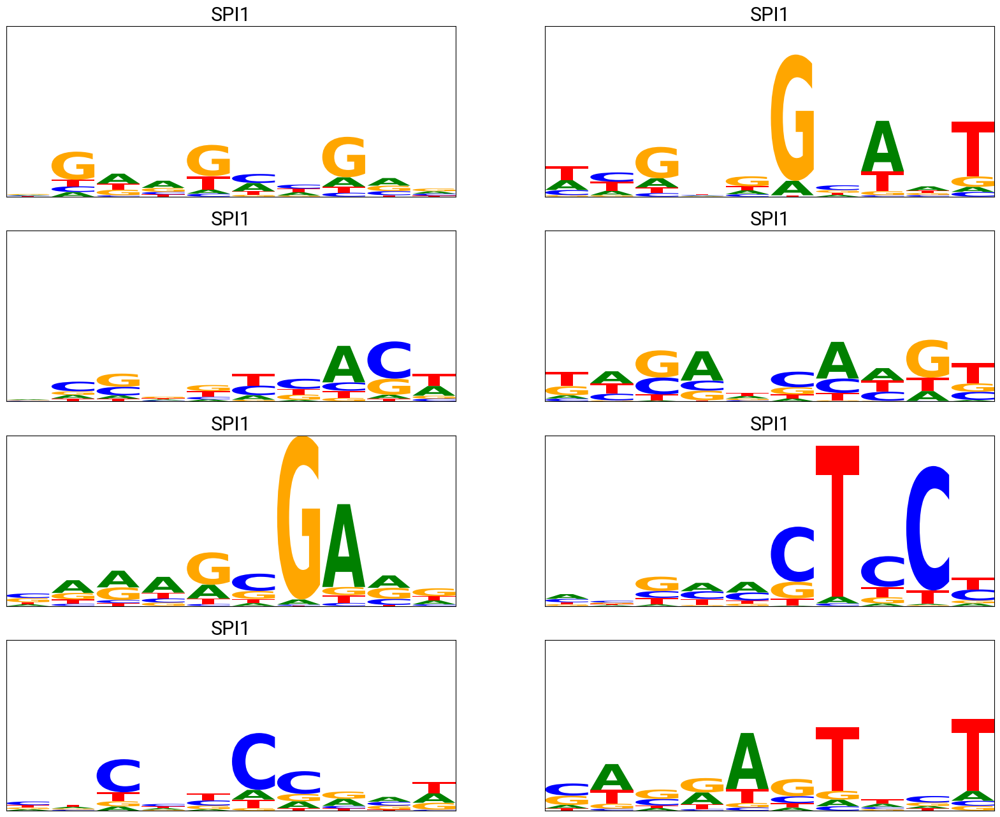

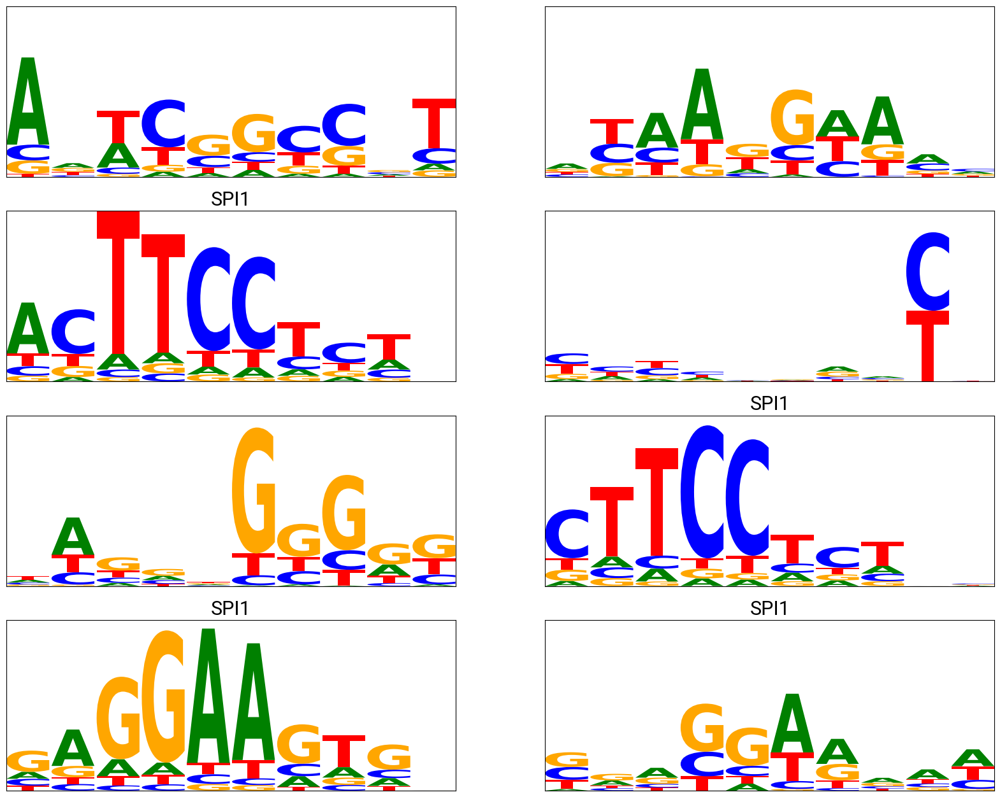

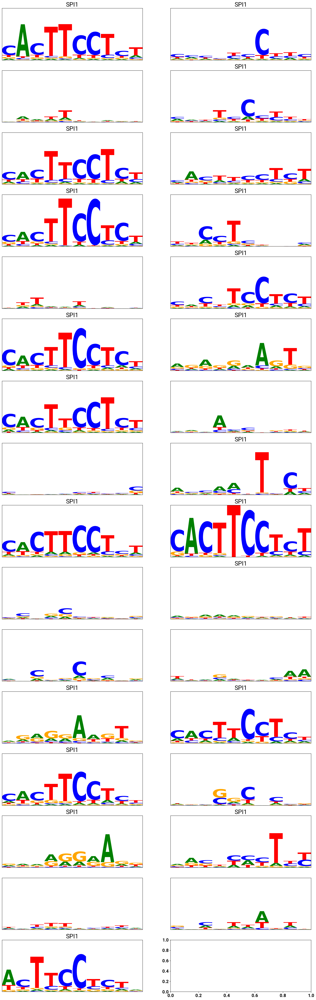

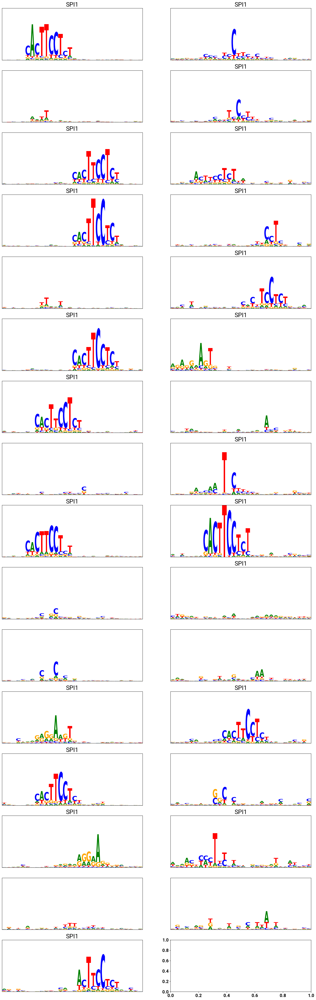

TAL/GATA


/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3

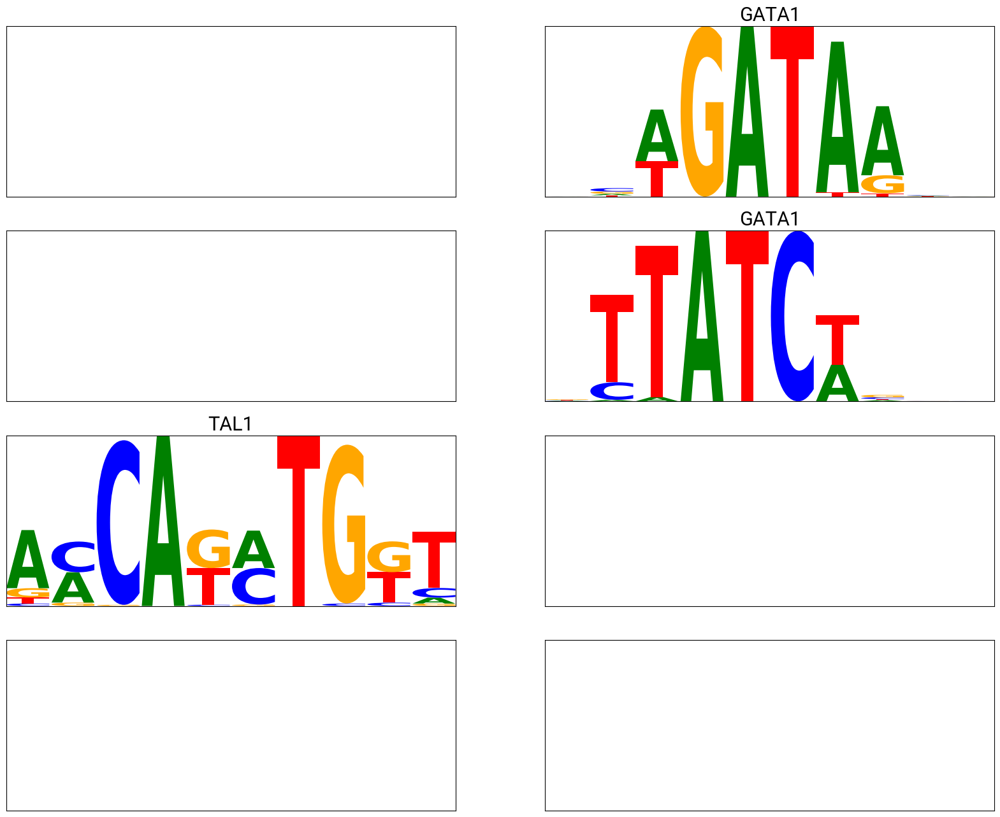

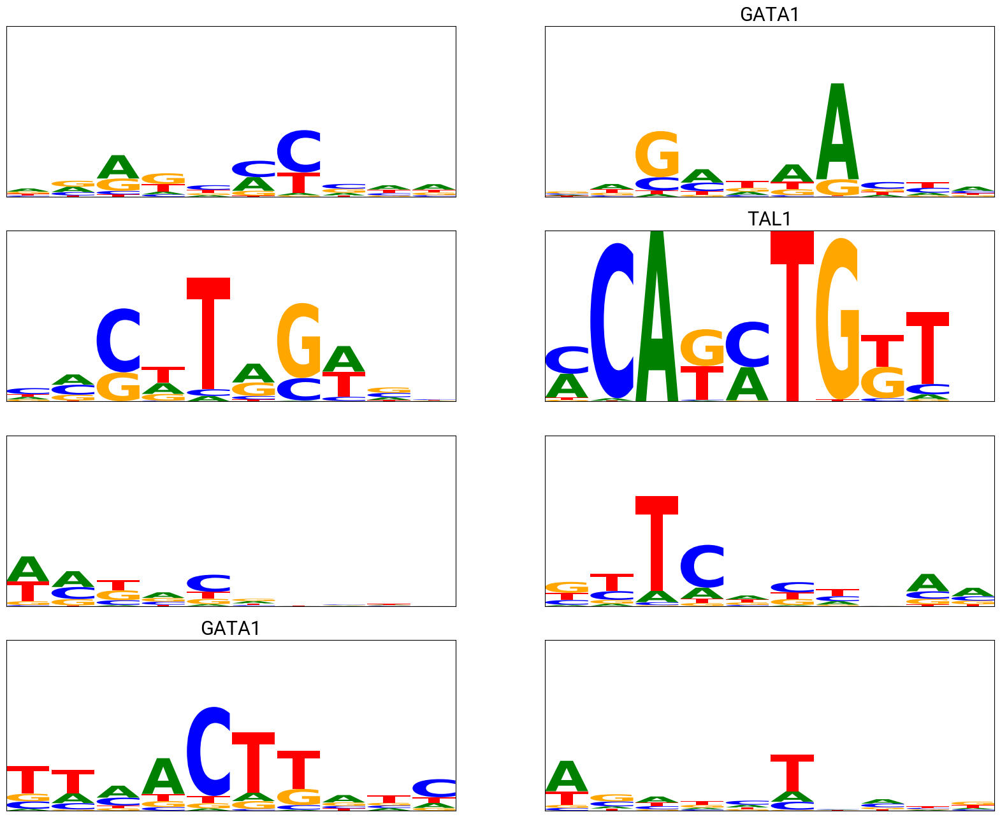

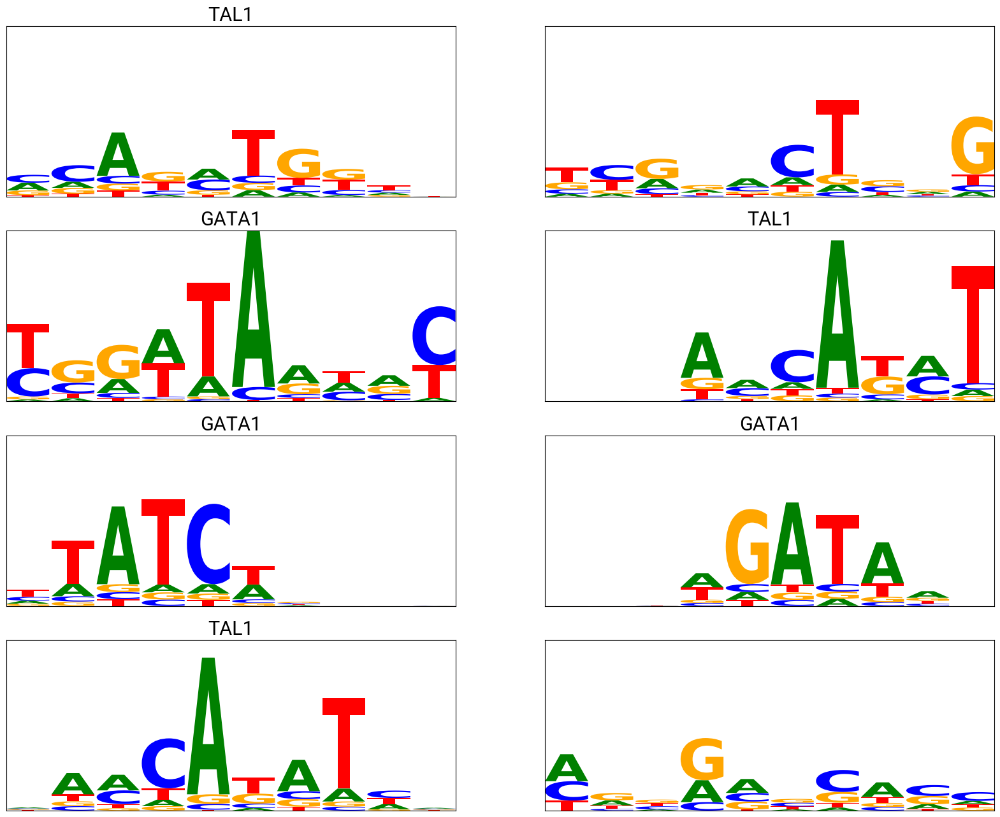

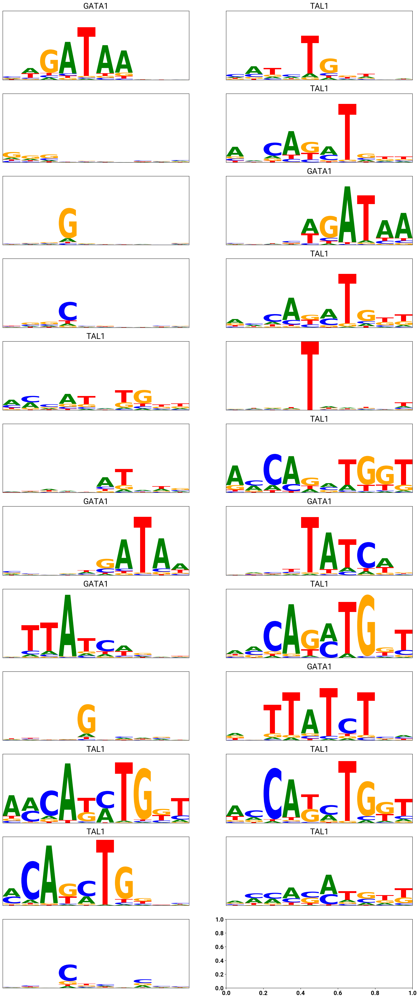

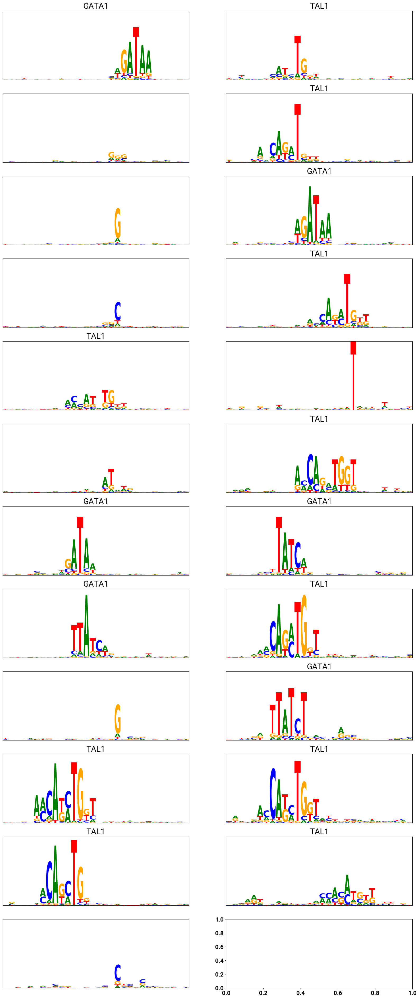

E2F6


/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3

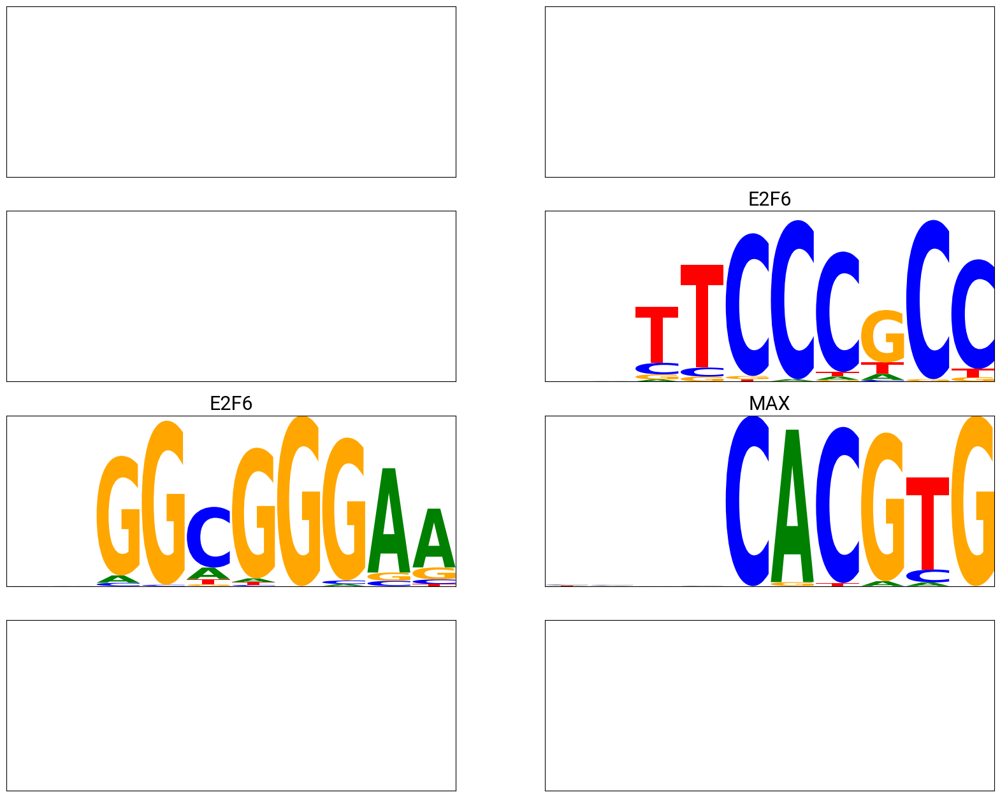

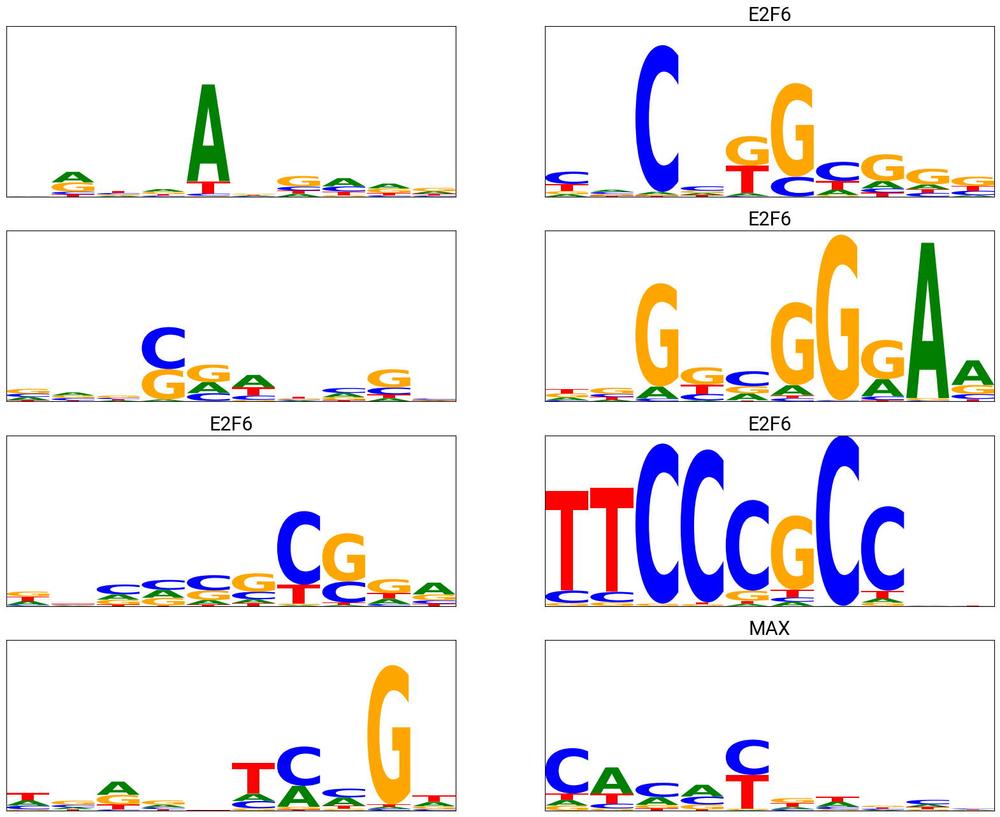

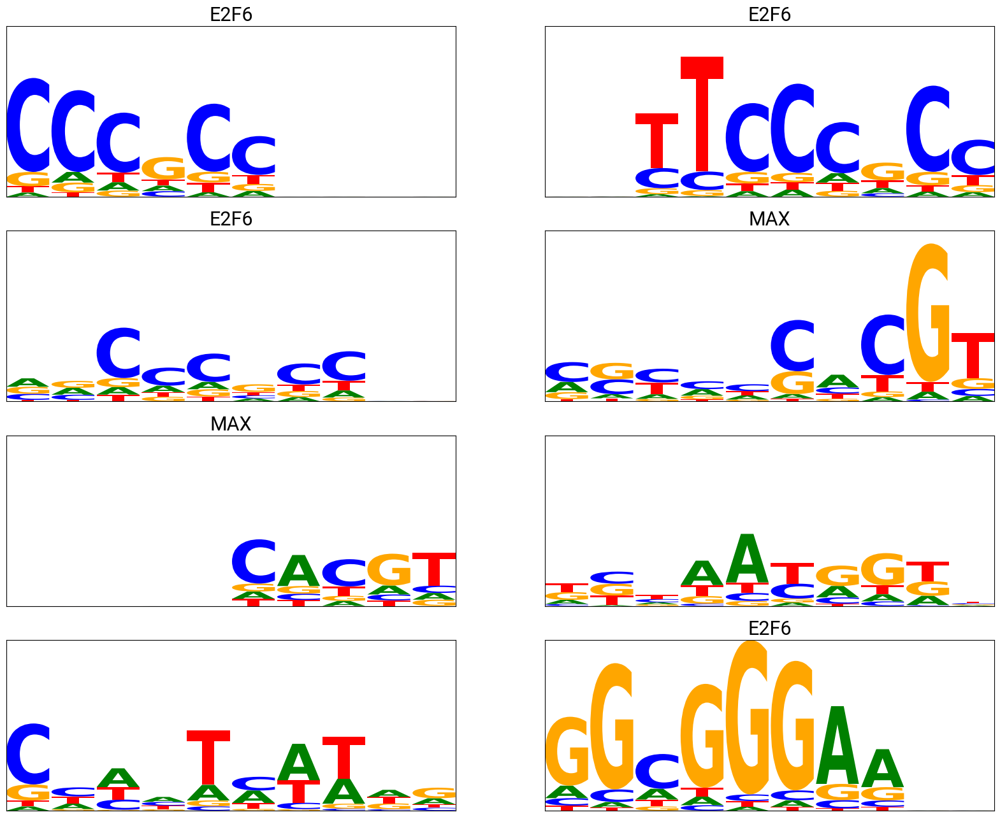

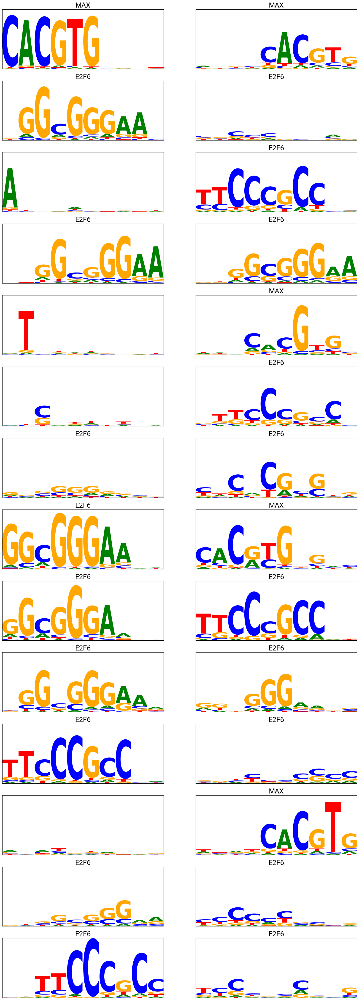

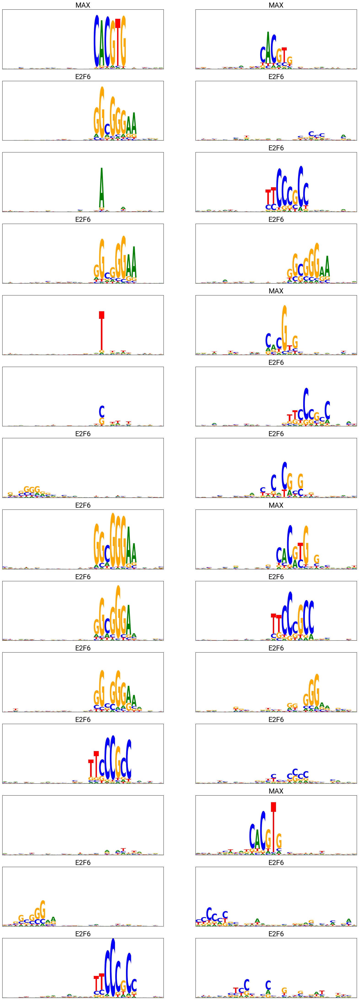

JUND/TEAD


/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3

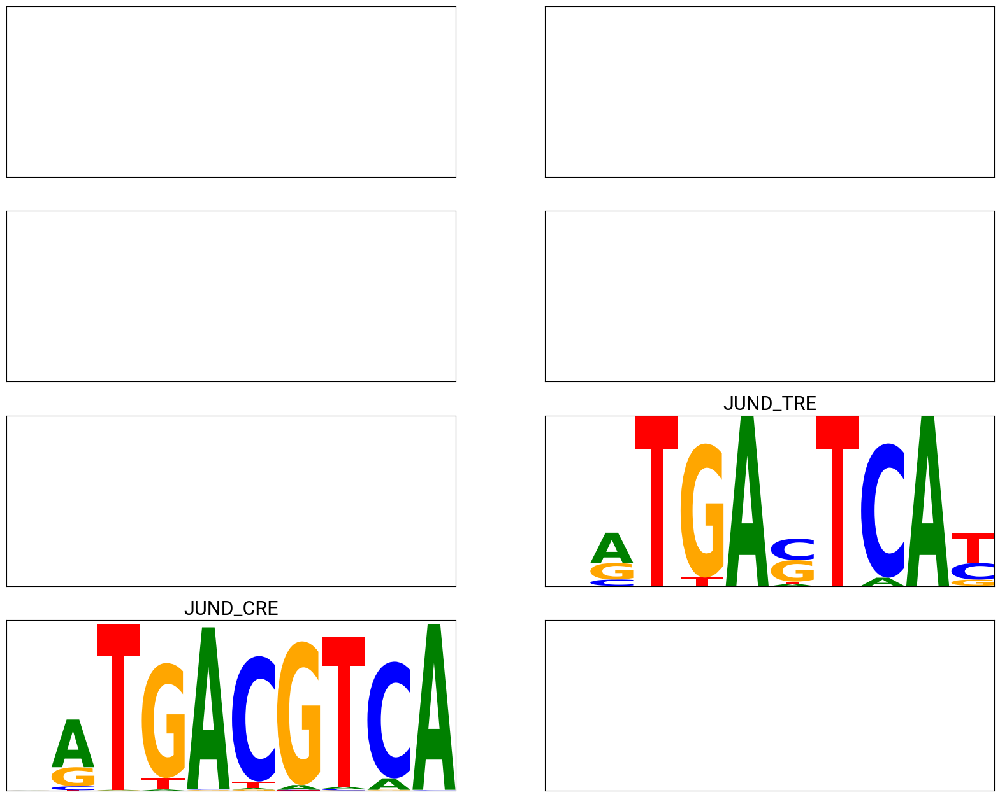

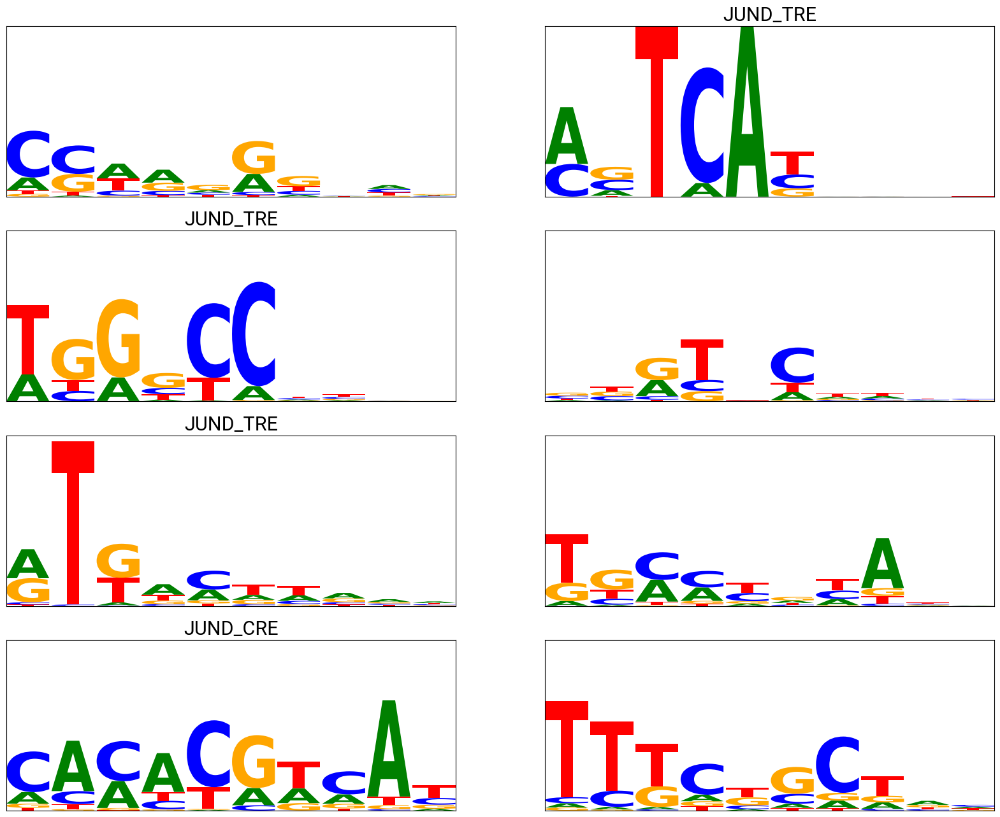

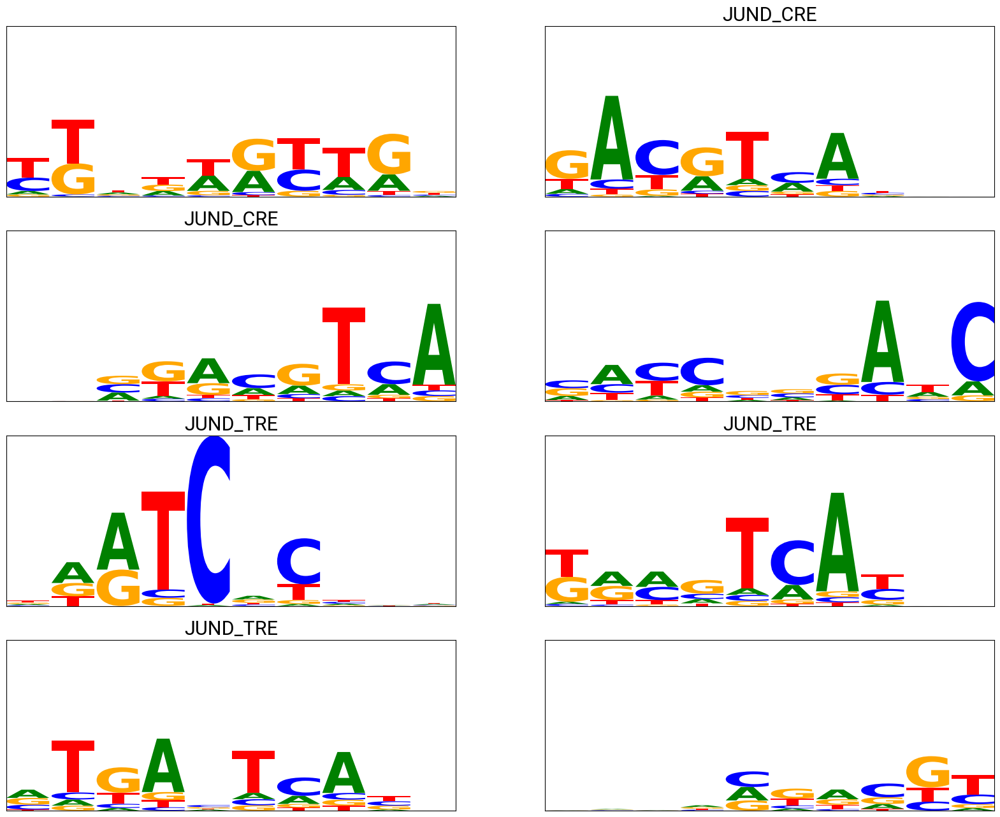

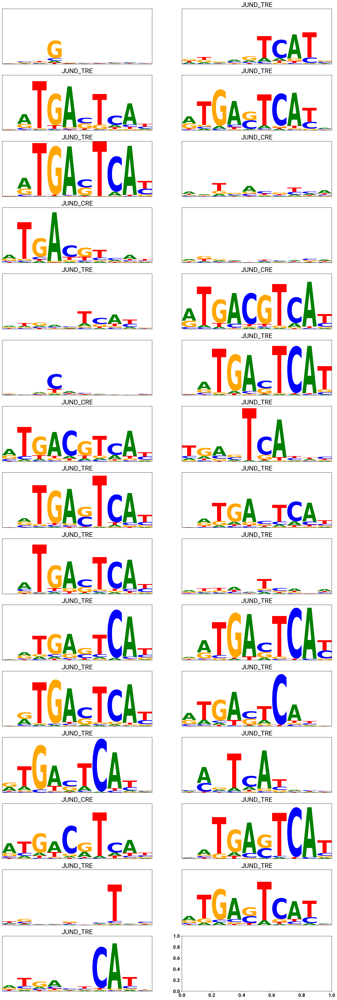

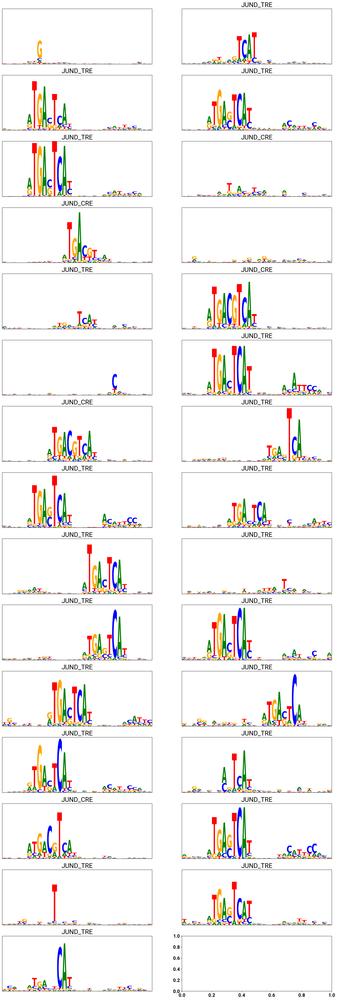

REST


/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])


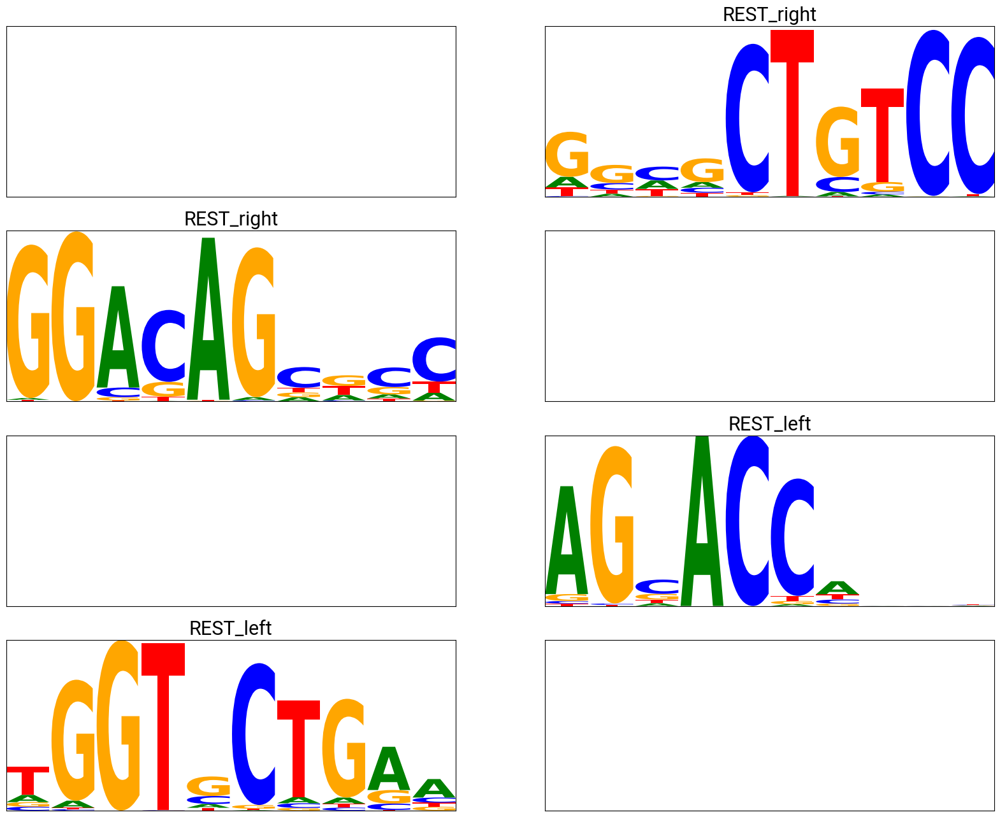

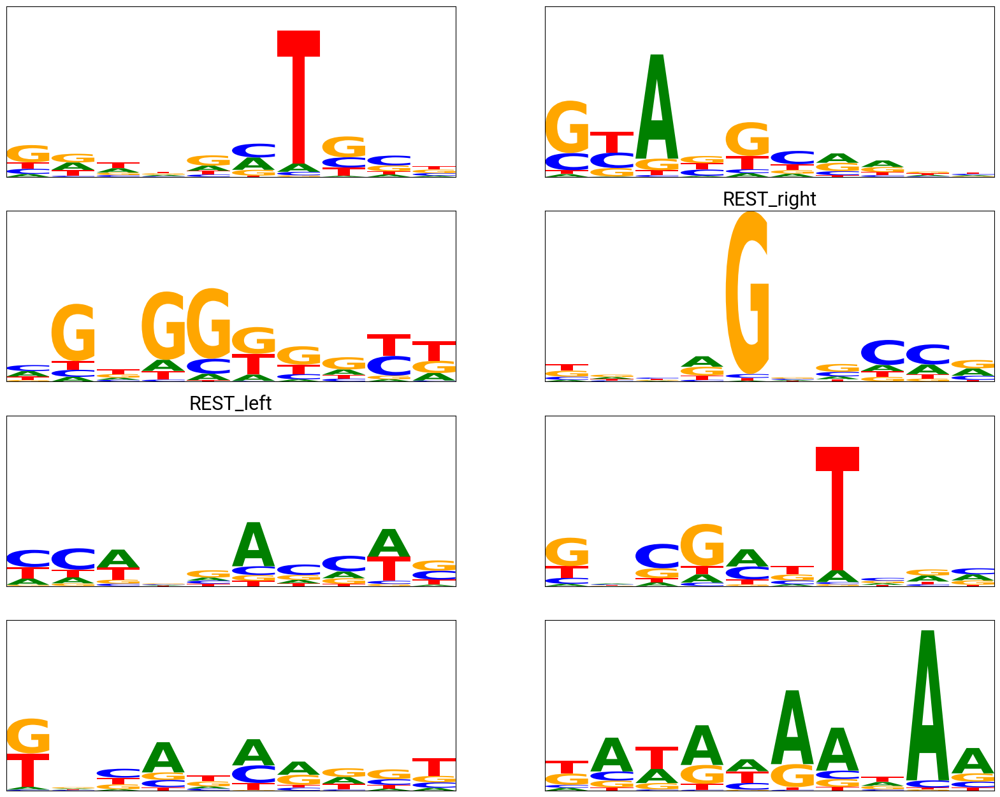

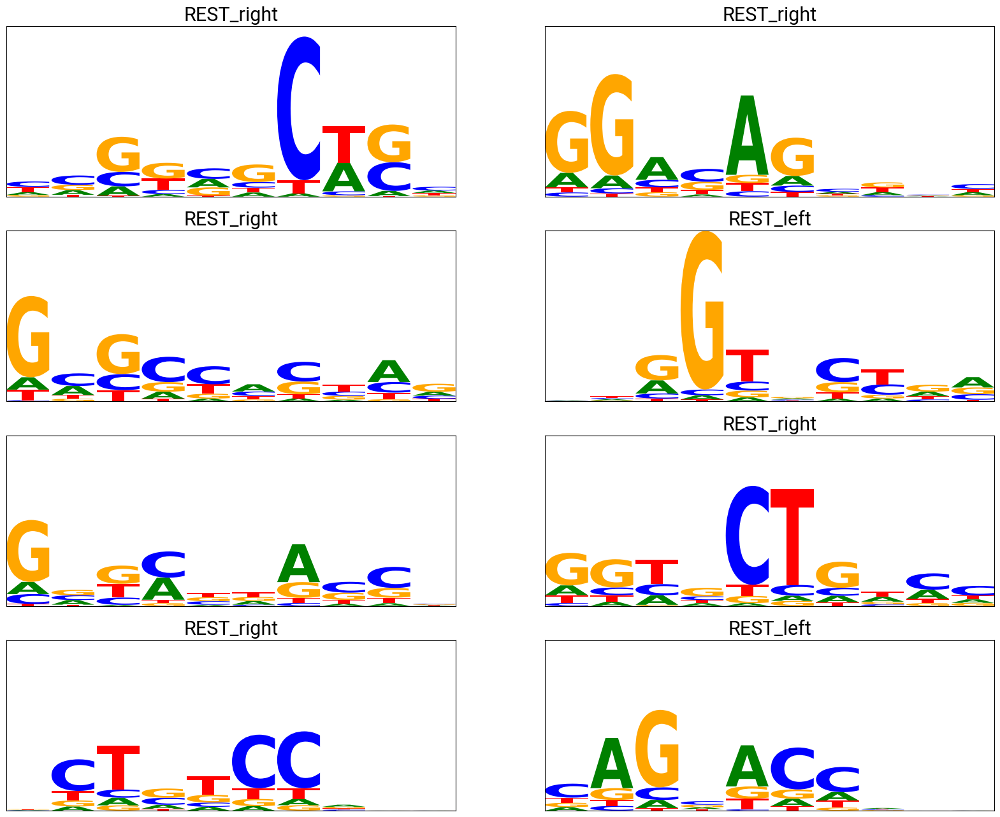

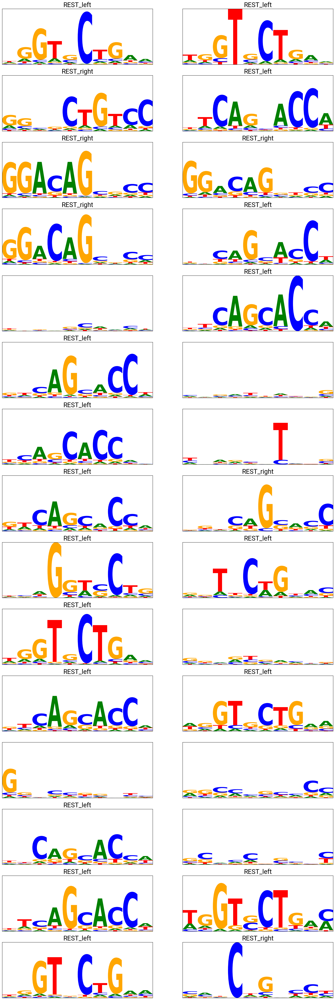

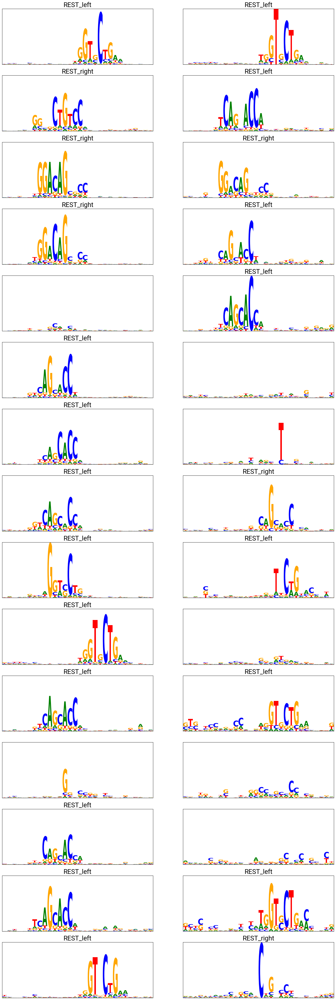

SPI1/CTCF


/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])


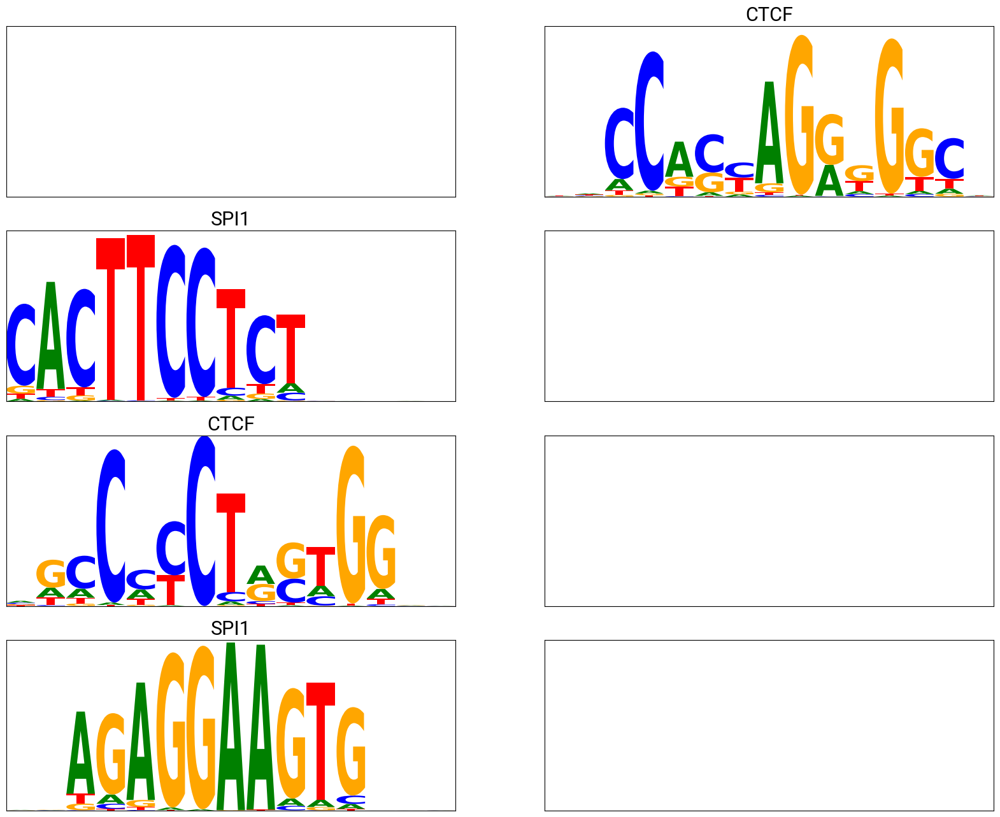

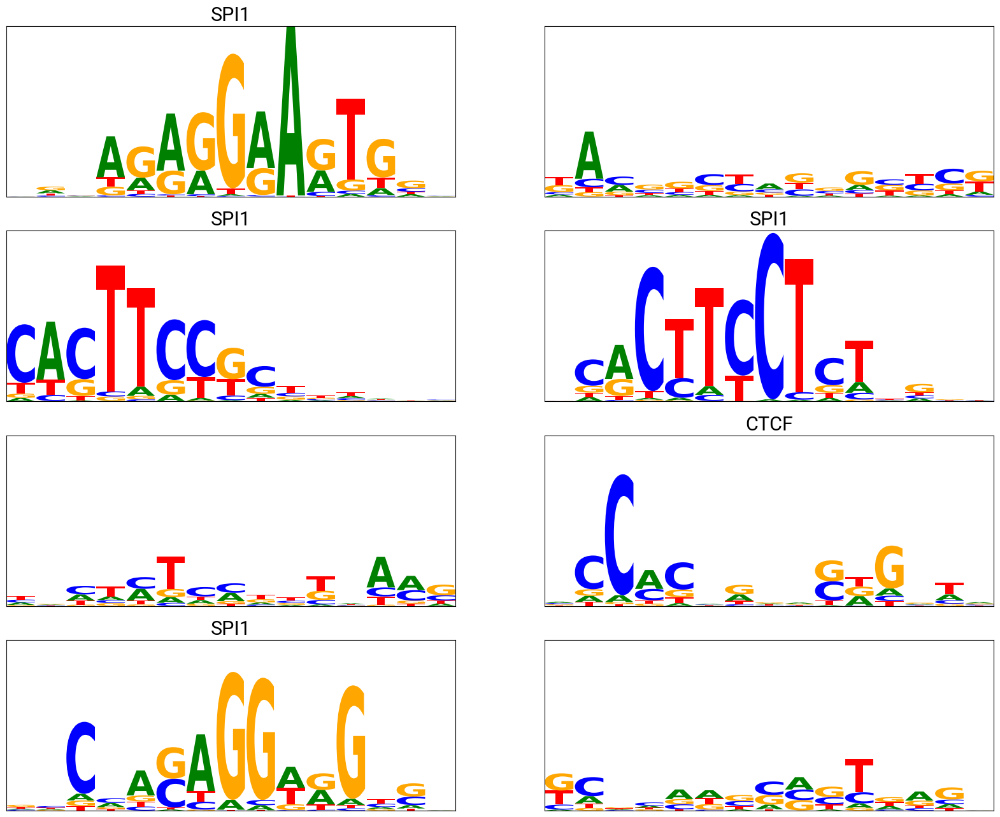

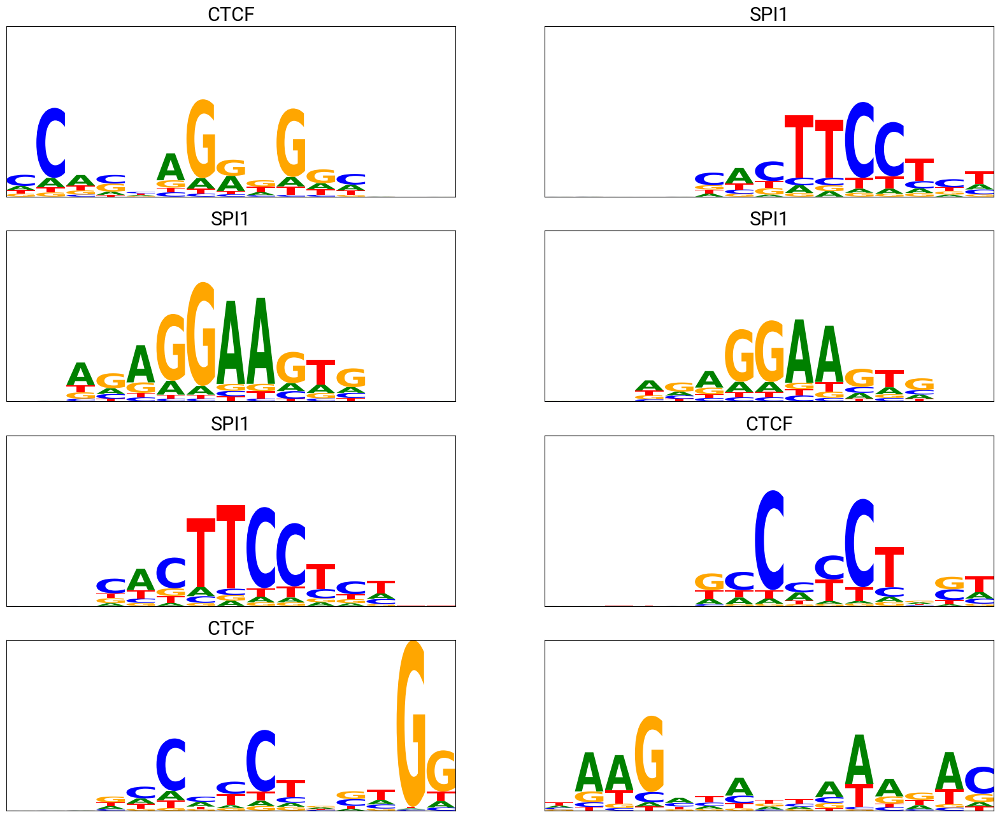

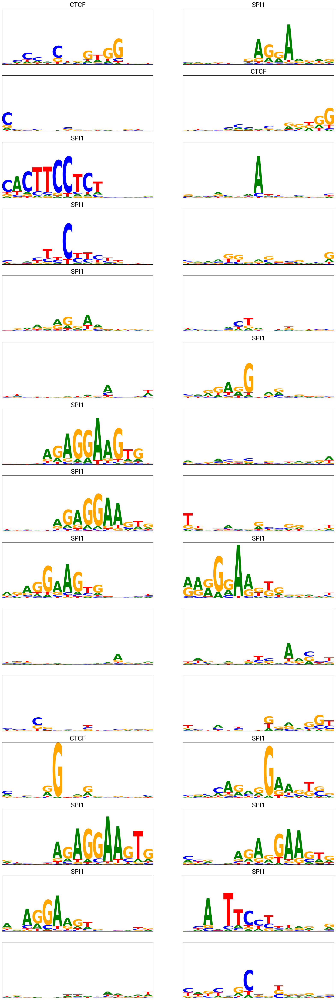

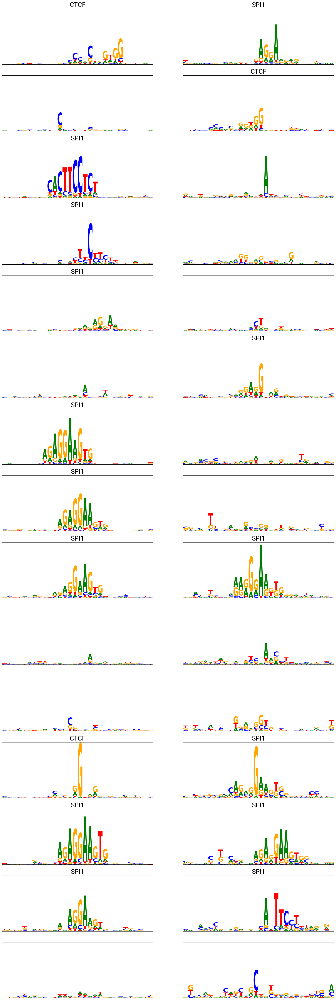

CTCF (HepG2)


/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])


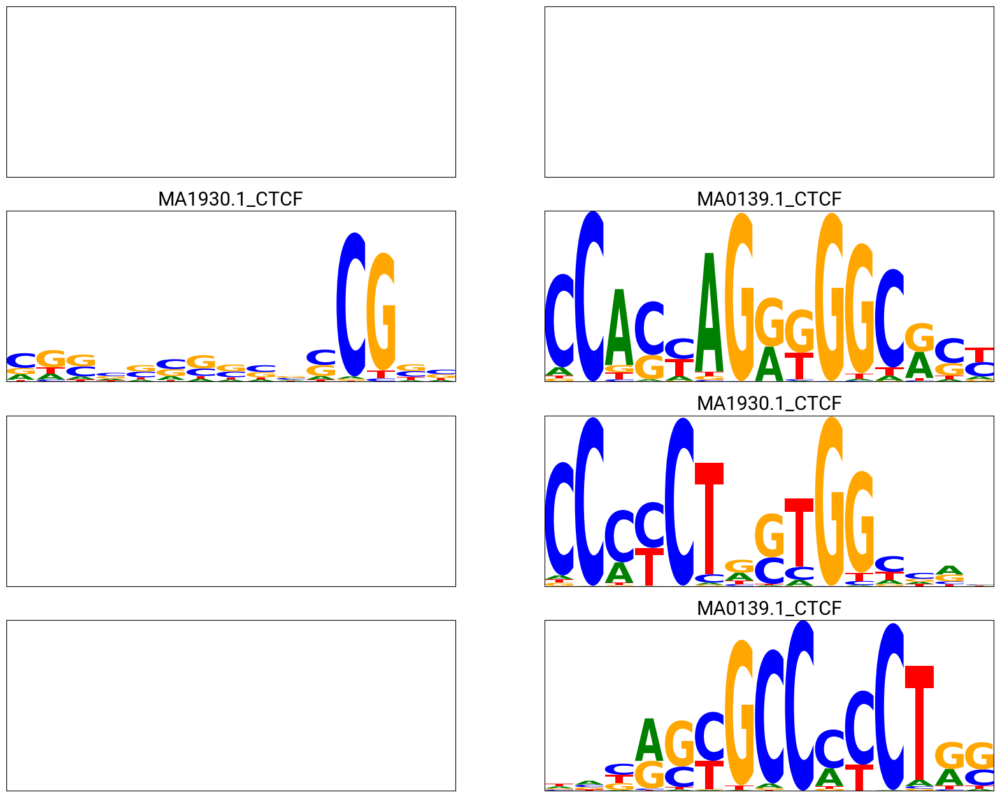

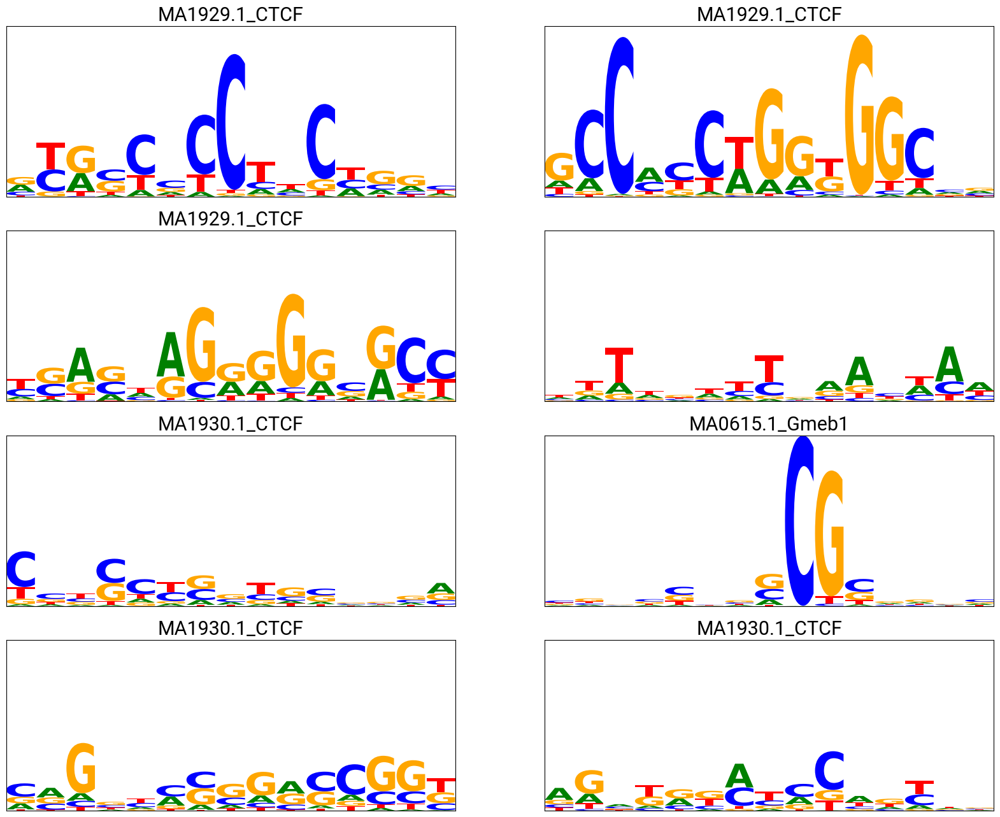

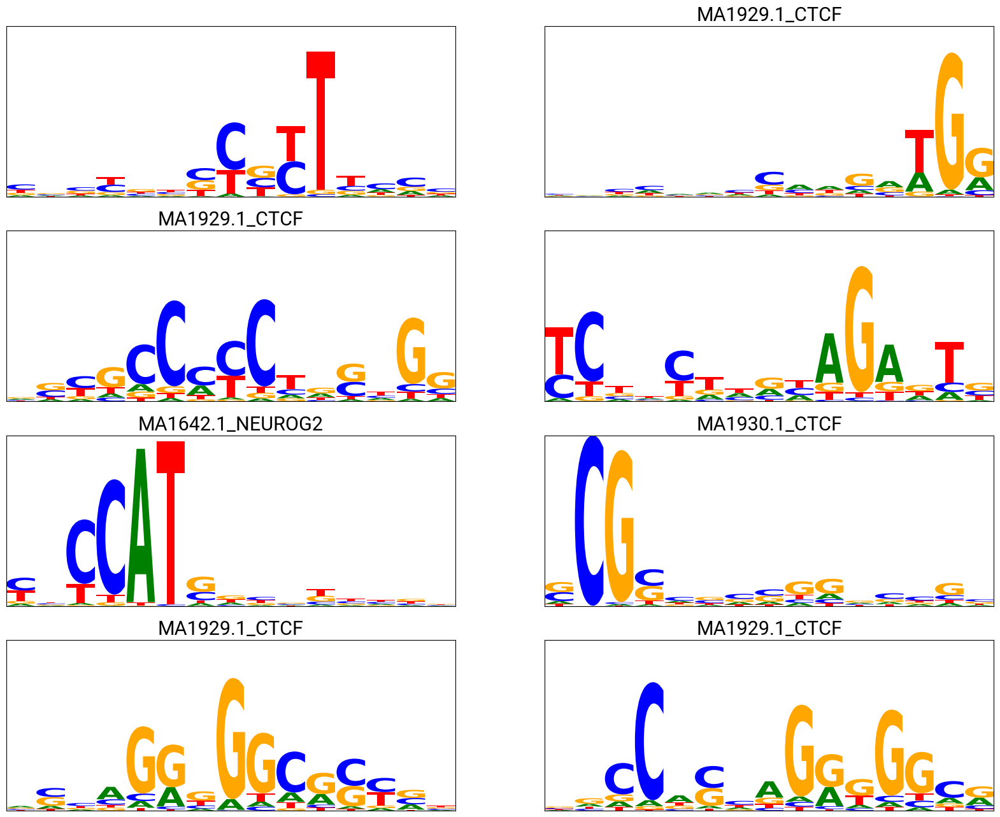

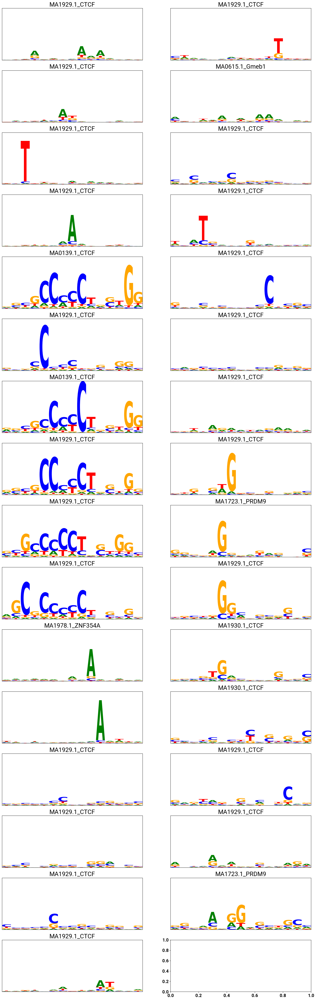

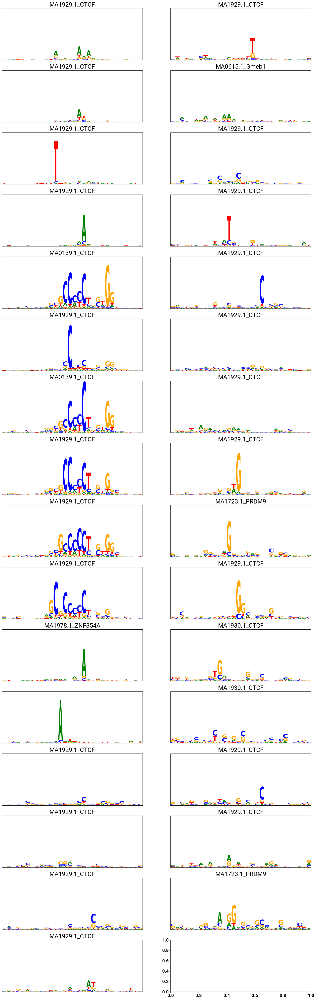

FOXA1 (HepG2)


/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])


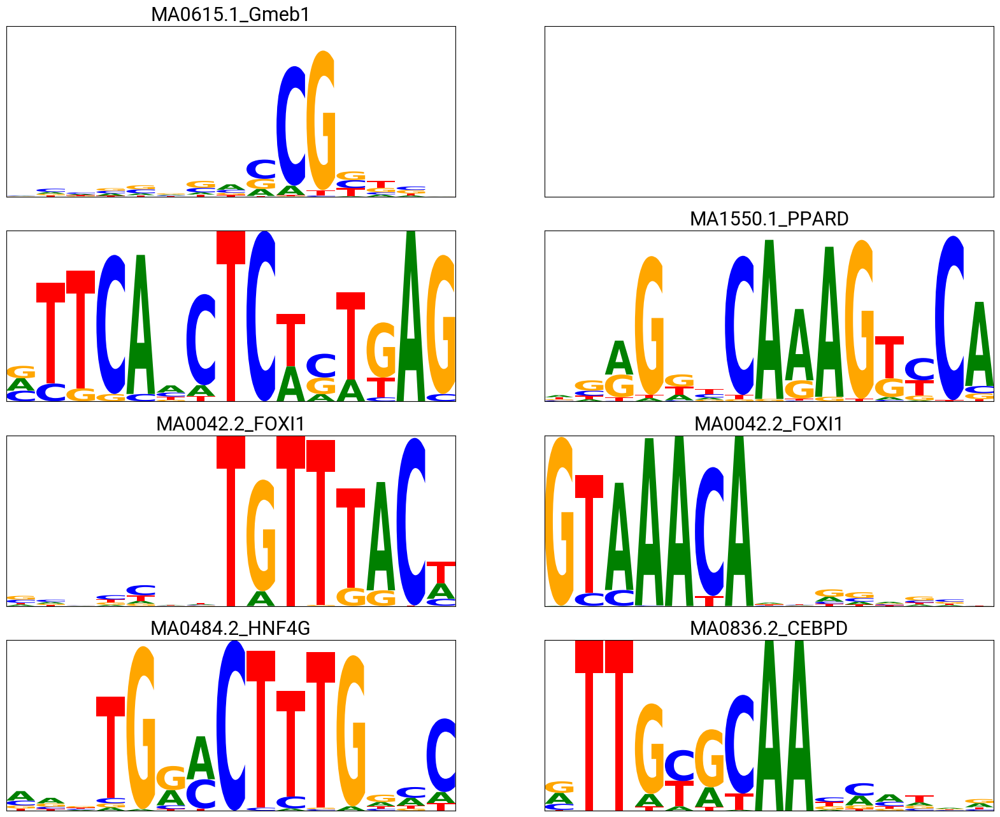

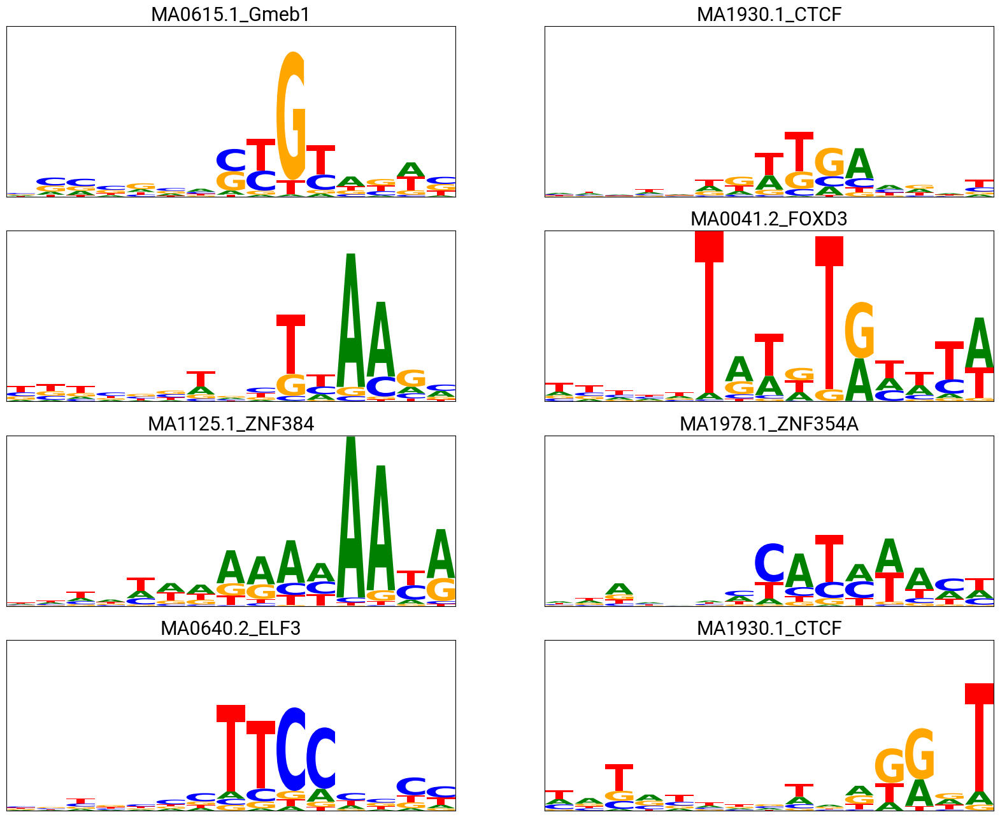

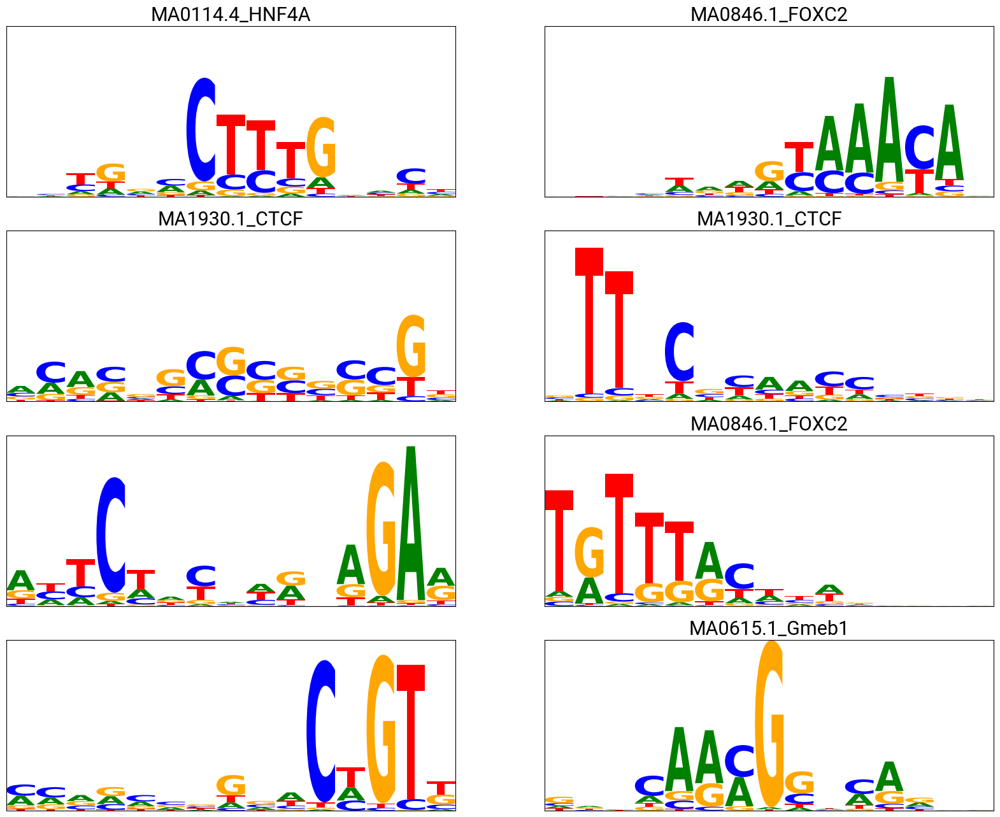

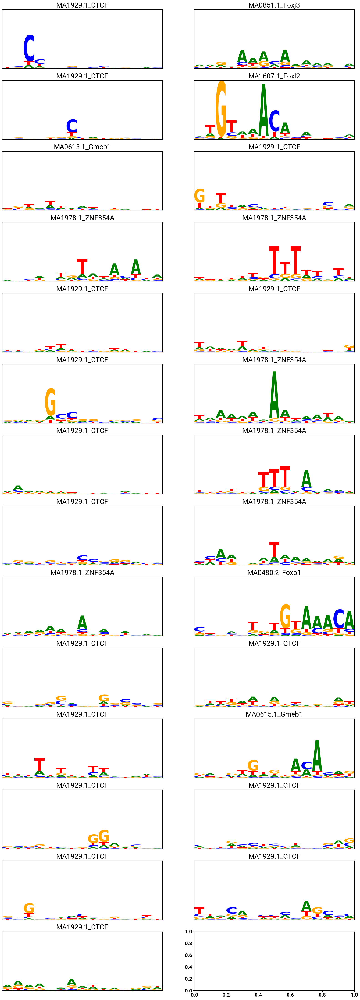

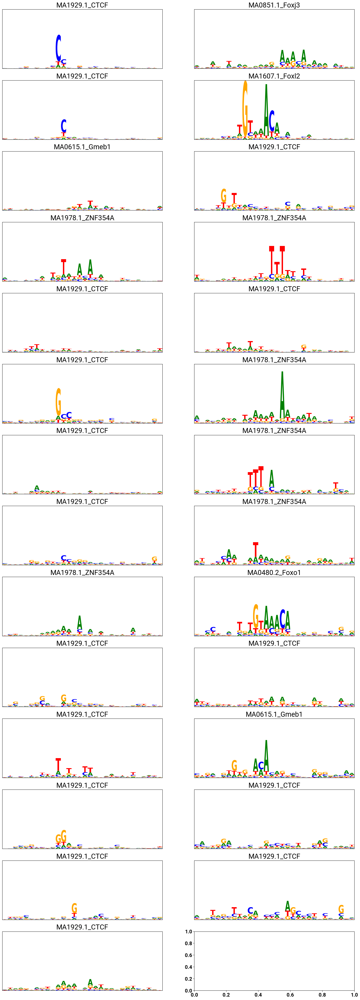

DNase (HepG2)


/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3

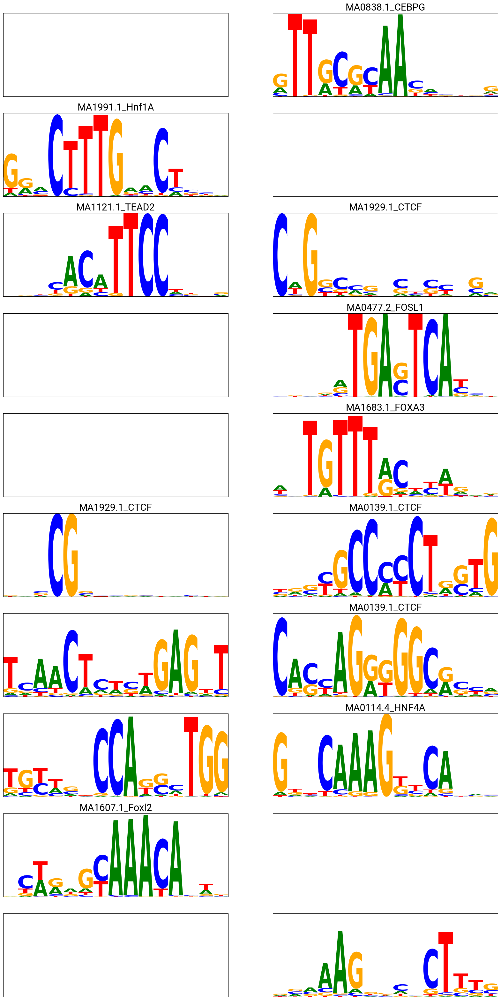

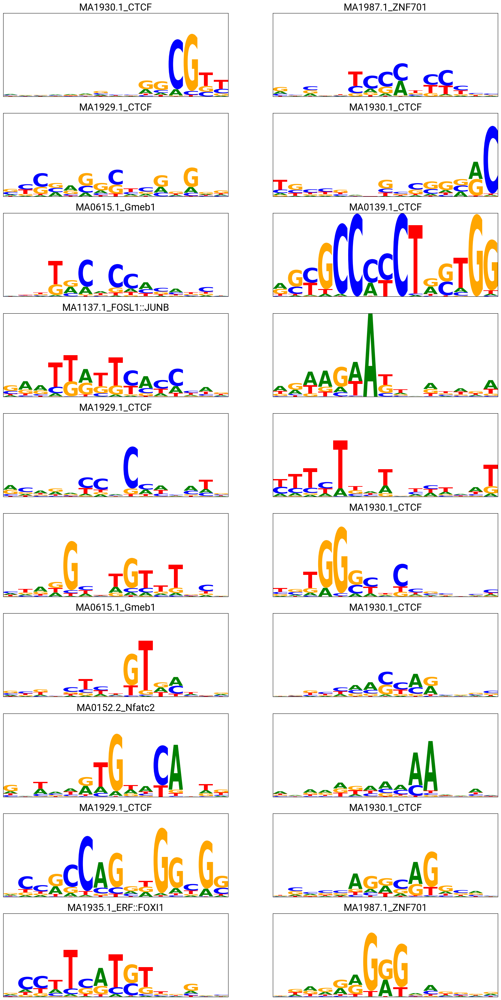

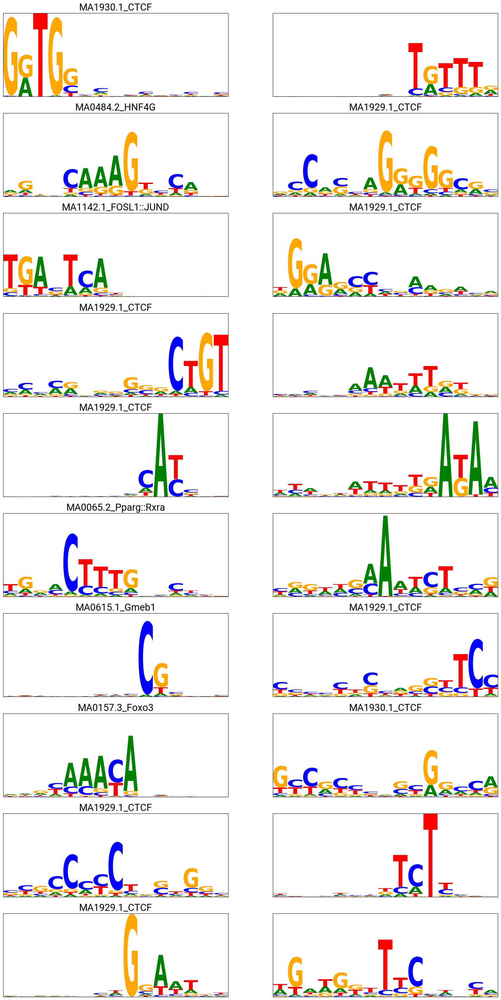

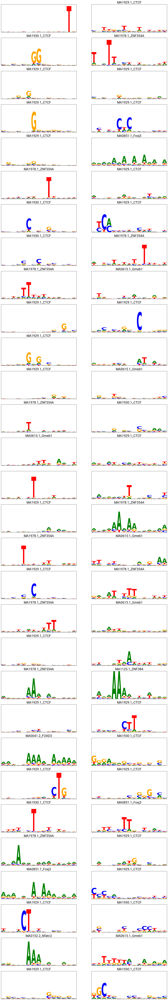

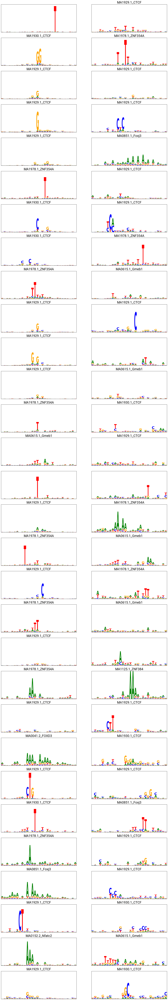

DNase (HL-60)


/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3

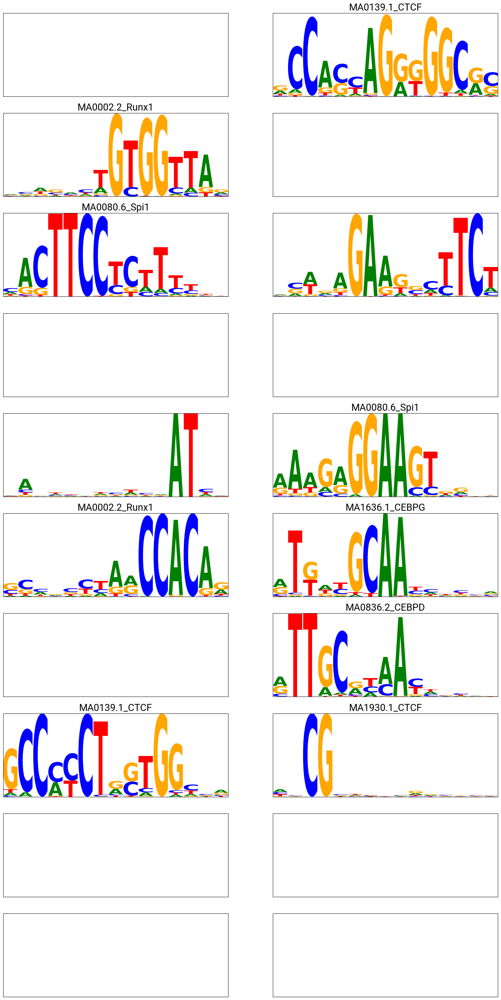

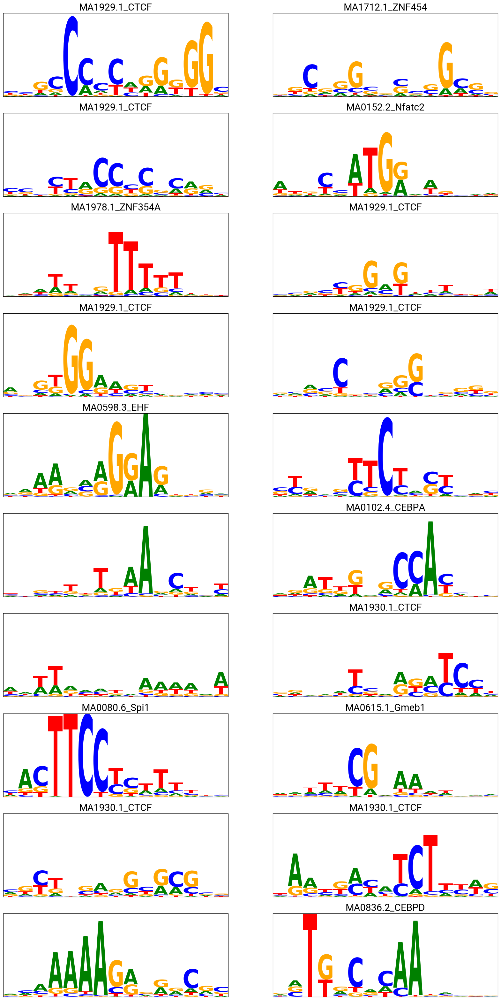

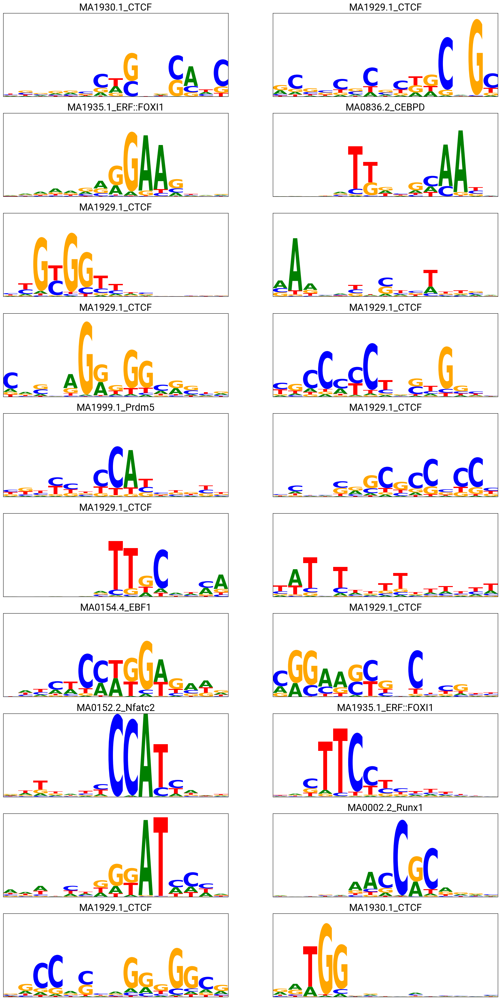

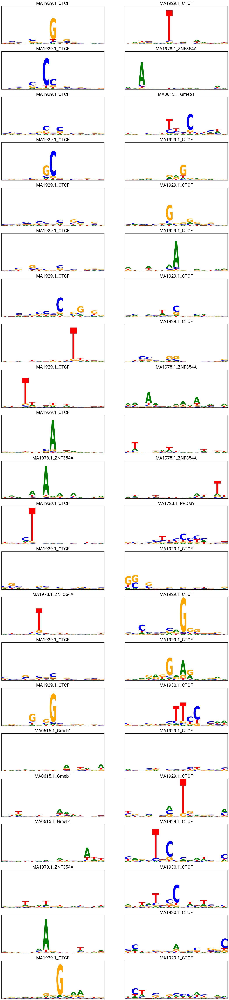

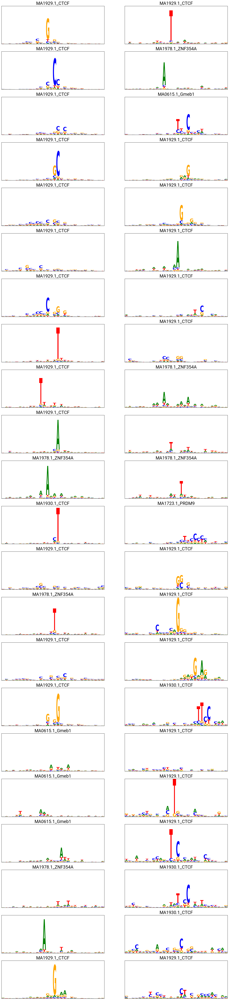

DNase (K562)


/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3/envs/mechint/lib/python3.12/site-packages/logomaker/src/Logo.py:1062: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  self.ax.set_ylim([ymin, ymax])
/home/tsenga5/miniforge3

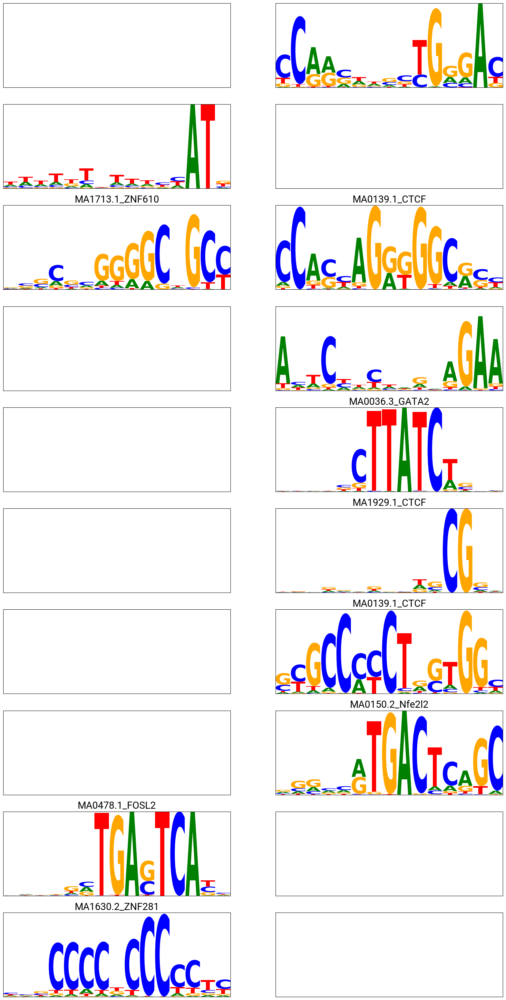

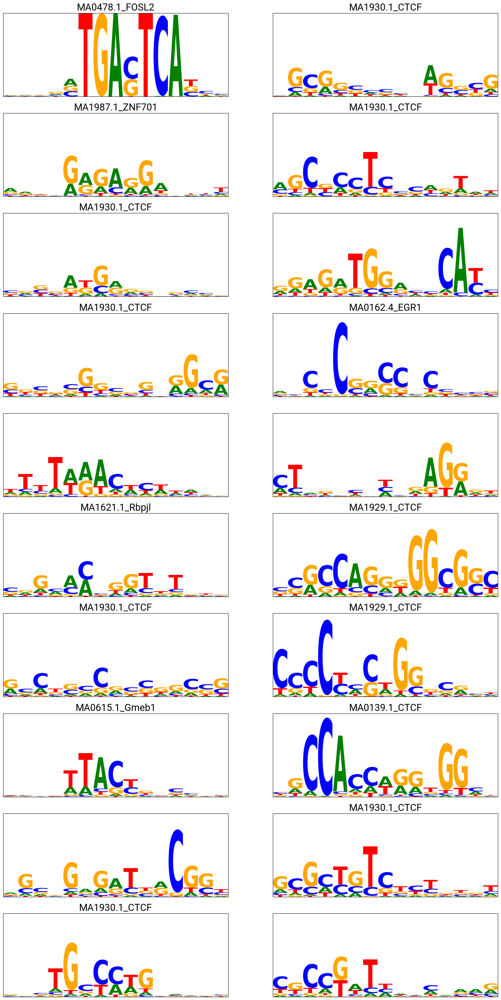

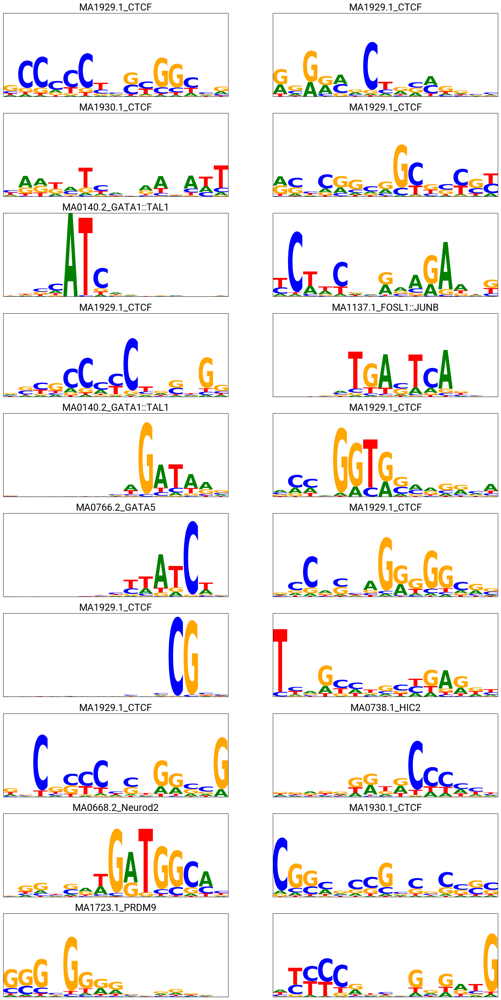

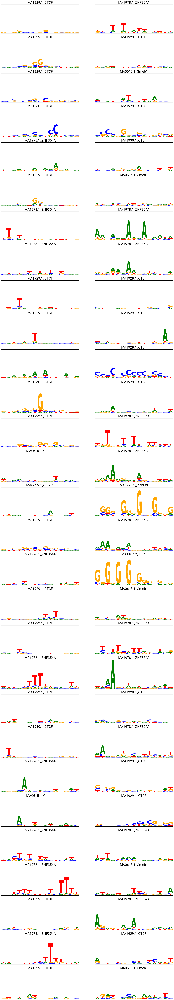

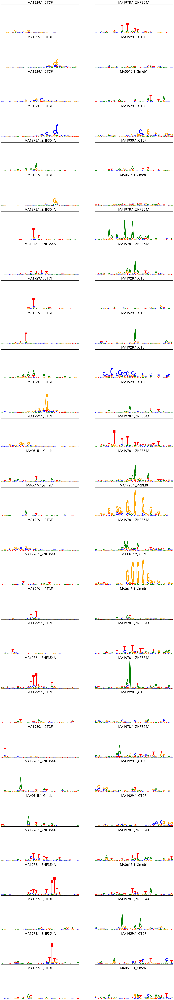

In [20]:
save_stem = os.path.join(figures_out_path, "motifs")
os.makedirs(save_stem, exist_ok=True)
for dataset_key in datasets:
    print(dataset_key)
    fig = plot_motifs.plot_motif_grid(
        [pfm * motif_util.pfm_info_content(pfm)[:, None] for pfm in mechint_pfms[dataset_key]],
        titles=[
            mechint_sims[dataset_key][i][0][0].rstrip("_exp") if mechint_pfms_used[dataset_key][i] and mechint_sims[dataset_key][i] else ""
            for i in range(len(mechint_pfms[dataset_key]))
        ],
        show_x=False, show_y=False
    )
    fig.savefig(os.path.join(save_stem, datasets_sanit[dataset_key] + "_mechint_filter_motifs.svg"), format="svg")
    fig = plot_motifs.plot_motif_grid(
        [pfm * motif_util.pfm_info_content(pfm)[:, None] for pfm in cnn_pfms[dataset_key]],
        titles=[
            cnn_sims[dataset_key][i][0][0].rstrip("_exp") if cnn_pfms_used[dataset_key][i] and cnn_sims[dataset_key][i] else ""
            for i in range(len(cnn_pfms[dataset_key]))
        ],
        show_x=False, show_y=False
    )
    fig.savefig(os.path.join(save_stem, datasets_sanit[dataset_key] + "_cnn_filter_motifs.svg"), format="svg")
    fig = plot_motifs.plot_motif_grid(
        [pfm * motif_util.pfm_info_content(pfm)[:, None] for pfm in explainn_pfms[dataset_key]],
        titles=[
            explainn_sims[dataset_key][i][0][0].rstrip("_exp") if explainn_pfms_used[dataset_key][i] and explainn_sims[dataset_key][i] else ""
            for i in range(len(explainn_pfms[dataset_key]))
        ],
        show_x=False, show_y=False
    )
    fig.savefig(os.path.join(save_stem, datasets_sanit[dataset_key] + "_explainn_filter_motifs.svg"), format="svg")
    fig = plot_motifs.plot_motif_grid(
        [pfm * motif_util.pfm_info_content(pfm)[:, None] for pfm in modisco_trimmed_pfms[dataset_key]],
        titles=[
            modisco_sims[dataset_key][i][0][0].rstrip("_exp") if modisco_sims[dataset_key][i] else ""
            for i in range(len(modisco_trimmed_pfms[dataset_key]))
        ],
        show_x=False, show_y=False
    )
    fig.savefig(os.path.join(save_stem, datasets_sanit[dataset_key] + "_modisco_trimmed_motifs.svg"), format="svg")
    fig = plot_motifs.plot_motif_grid(
        [pfm * motif_util.pfm_info_content(pfm)[:, None] for pfm in modisco_pfms[dataset_key]],
        titles=[
            modisco_sims[dataset_key][i][0][0].rstrip("_exp") if modisco_sims[dataset_key][i] else ""
            for i in range(len(modisco_pfms[dataset_key]))
        ],
        show_x=False, show_y=False
    )
    fig.savefig(os.path.join(save_stem, datasets_sanit[dataset_key] + "_modisco_untrimmed_motifs.svg"), format="svg")
    plt.show()

### For experimental datasets, examine the pool of all matches to find "relevant" motifs
For simulated datsets, the "relevant" motifs are defined in the configuration

In [21]:
# Show the set of motifs found in the union of all top matches for experimental datasets
for dataset_key in datasets:
    top_motif_keys = dict()
    
    # Extract top match for each motif
    for i, sims in enumerate([mechint_sims, cnn_sims, explainn_sims, modisco_sims]):
        matches = sims[dataset_key]
        for match_set in matches:
            # Each match set is the set of matches for one discovered motif
            if not match_set:
                # No match found for this motif
                continue
            motif_key = match_set[0][0].split("_")[1]
            if motif_key not in top_motif_keys:
                top_motif_keys[motif_key] = [0, 0, 0, 0]
            top_motif_keys[motif_key][i] += 1

    print(dataset_key)
    print(top_motif_keys)

SPI1
{'exp': [2, 7, 4, 21]}
TAL/GATA
{'exp': [3, 3, 6, 16]}
E2F6
{'exp': [3, 5, 6, 24]}
JUND/TEAD
{'CRE': [1, 1, 2, 5], 'TRE': [1, 3, 3, 21]}
REST
{'right': [2, 1, 5, 6], 'left': [2, 1, 2, 17]}
SPI1/CTCF
{'exp': [4, 5, 7, 17]}
CTCF (HepG2)
{'CTCF': [4, 6, 5, 26], 'Gmeb1': [0, 1, 0, 1], 'NEUROG2': [0, 0, 1, 0], 'ZNF354A': [0, 0, 0, 1], 'PRDM9': [0, 0, 0, 2]}
FOXA1 (HepG2)
{'Gmeb1': [1, 1, 1, 2], 'FOXI1': [2, 0, 0, 0], 'HNF4G': [1, 0, 0, 0], 'PPARD': [1, 0, 0, 0], 'CEBPD': [1, 0, 0, 0], 'ZNF384': [0, 1, 0, 0], 'ELF3': [0, 1, 0, 0], 'CTCF': [0, 2, 2, 16], 'FOXD3': [0, 1, 0, 0], 'ZNF354A': [0, 1, 0, 6], 'HNF4A': [0, 0, 1, 0], 'FOXC2': [0, 0, 2, 0], 'Foxj3': [0, 0, 0, 1], 'Foxl2': [0, 0, 0, 1], 'Foxo1': [0, 0, 0, 1]}
DNase (HepG2)
{'Hnf1A': [1, 0, 0, 0], 'TEAD2': [1, 0, 0, 0], 'CTCF': [4, 9, 9, 32], 'Foxl2': [1, 0, 0, 0], 'CEBPG': [1, 0, 0, 0], 'FOSL1': [1, 0, 0, 0], 'FOXA3': [1, 0, 0, 0], 'HNF4A': [1, 0, 0, 0], 'Gmeb1': [0, 2, 1, 6], 'FOSL1::JUNB': [0, 1, 0, 0], 'Nfatc2': [0, 1, 0, 1], 'ER

In [22]:
# Define the set of relevant motifs for each dataset
# * means the motif is RC-symmetric, so combine forward/reverse orientations
relevant_motifs = {
    "SPI1": ["SPI1"],
    "TAL/GATA": ["TAL*", "GATA1"],
    "E2F6": ["E2F6", "MAX*"],
    "JUND/TEAD": ["JUND_TRE*", "JUND_CRE*"],
    "REST": ["REST_left", "REST_right"],
    "SPI1/CTCF": ["SPI1", "CTCF"],
    "CTCF (HepG2)": ["CTCF"],
    "FOXA1 (HepG2)": ["FOX", "HNF4", "CEBP"],
    "MAX (HepG2)": ["MAX"],
    "DNase (HepG2)": ["HNF", "TEAD", "CTCF", "FOX", "CEBP", "FOS::JUN"],
    "DNase (HL-60)": ["RUNX", "CTCF", "FOX", "CEBP", "SPI1"],
    "DNase (K562)": ["FOSL2::JUN", "CTCF", "GATA"]
}

### Compute motif matches
For each motif discovered, map it to the closest relevant motif, or nothing at all

In [23]:
# Limit the set of true PFMs to only those matching relevant motifs
relevant_pfms = {}
for dataset_key in datasets:
    relevant_motif_keys = [k.rstrip("*") for k in relevant_motifs[dataset_key]]
    # Keep a true PFM as relevant if it matches any of the selected relevant keys above
    relevant_pfms[dataset_key] = {
        motif_key : pfm for motif_key, pfm in true_pfms[dataset_key].items()
        if any([k.upper() in motif_key.upper() for k in relevant_motif_keys])
    }

In [24]:
# Recompute similarities using only the relevant-motif list
mechint_rel_sims, cnn_rel_sims, explainn_rel_sims, modisco_rel_sims = {}, {}, {}, {}
for dataset_key in tqdm.notebook.tqdm(datasets):
    # Run TOMTOM
    mechint_subtables = motif_compare.run_tomtom(
        {i : pfm for i, pfm in enumerate(mechint_pfms[dataset_key]) if mechint_pfms_used[dataset_key][i]},
        relevant_pfms[dataset_key]
    )
    cnn_subtables = motif_compare.run_tomtom(
        {i : pfm for i, pfm in enumerate(cnn_pfms[dataset_key]) if cnn_pfms_used[dataset_key][i]},
        relevant_pfms[dataset_key]
    )
    explainn_subtables = motif_compare.run_tomtom(
        {i : pfm for i, pfm in enumerate(explainn_pfms[dataset_key]) if explainn_pfms_used[dataset_key][i]},
        relevant_pfms[dataset_key]
    )
    modisco_subtables = motif_compare.run_tomtom(dict(enumerate(modisco_pfms[dataset_key])), relevant_pfms[dataset_key])

    # Collect matches, saving match key, orientation, and q-value
    mechint_rel_sims[dataset_key] = extract_tomtom_matches(len(mechint_pfms[dataset_key]), mechint_subtables)
    cnn_rel_sims[dataset_key] = extract_tomtom_matches(len(cnn_pfms[dataset_key]), cnn_subtables)
    explainn_rel_sims[dataset_key] = extract_tomtom_matches(len(explainn_pfms[dataset_key]), explainn_subtables)
    modisco_rel_sims[dataset_key] = extract_tomtom_matches(len(modisco_pfms[dataset_key]), modisco_subtables)

  0%|          | 0/11 [00:00<?, ?it/s]

In [25]:
# For each discovered motif, match to the most-similar relevant motif, or None if the best match is too poor
# For filter-based methods, the match is also None if the filter was empty/never used
min_match_score = -np.log10(0.5)

mechint_rel_matches, cnn_rel_matches, explainn_rel_matches, modisco_rel_matches = {}, {}, {}, {}
for dataset_key in datasets:
    mechint_rel_matches[dataset_key] = [
        (row[0] if (row and row[0][2] >= min_match_score and mechint_pfms_used[dataset_key][i]) else None)
        for i, row in enumerate(mechint_rel_sims[dataset_key])
    ]
    cnn_rel_matches[dataset_key] = [
        (row[0] if (row and row[0][2] >= min_match_score and cnn_pfms_used[dataset_key][i]) else None)
        for i, row in enumerate(cnn_rel_sims[dataset_key])
    ]
    explainn_rel_matches[dataset_key] = [
        (row[0] if (row and row[0][2] >= min_match_score and explainn_pfms_used[dataset_key][i]) else None)
        for i, row in enumerate(explainn_rel_sims[dataset_key])
    ]
    modisco_rel_matches[dataset_key] = [
        (row[0] if (row and row[0][2] >= min_match_score) else None) for row in modisco_rel_sims[dataset_key]
    ]

### Plot motif stats

In [26]:
# Compute number of relevant motifs missed, redundant motifs found, and extraneous motifs found

# Count the discovered motifs which match a given relevant motif key
# Ignore orientation if it is None
matches_to_count = lambda matches, motif_key, orientation: len([
    match for match in matches
    if (match and (motif_key.upper() in match[0].upper()) and (orientation is None or match[1] == orientation))
])

rel_motif_counts = {}
extra_motif_counts = {}
for dataset_key in datasets:
    motif_keys = relevant_motifs[dataset_key]
    rel_motif_counts[dataset_key] = []
    matched_motif_counts = [0, 0, 0, 0]
    for motif_key in motif_keys:
        combine_rc = motif_key.endswith("*")
        motif_key = motif_key[:-1] if combine_rc else motif_key
        orientations = (None,) if combine_rc else (False, True)

        # For non-RC-symmetric relevant motifs, add an entry for each orientation
        # For RC-symmetric relevant motifs, combine across orientations
        new_entries = []
        for orientation in orientations:
            mechint_val = matches_to_count(mechint_rel_matches[dataset_key], motif_key, orientation)
            cnn_val = matches_to_count(cnn_rel_matches[dataset_key], motif_key, orientation)
            explainn_val = matches_to_count(explainn_rel_matches[dataset_key], motif_key, orientation)
            modisco_val = matches_to_count(modisco_rel_matches[dataset_key], motif_key, orientation)

            # Add to running count of the total number of motifs matched to a relevant motif
            # Do this now, because the MoDISco counts are modified in the next step
            matched_motif_counts[0] += mechint_val
            matched_motif_counts[1] += cnn_val
            matched_motif_counts[2] += explainn_val
            matched_motif_counts[3] += modisco_val

            new_entries.append((motif_key, orientation, mechint_val, cnn_val, explainn_val, modisco_val))

        # MoDISco motifs only come in one orientation, so take the maximum of all orientations
        max_modisco_val = max(tup[5] for tup in new_entries)
        new_entries = [tup[:5] + (max_modisco_val,) for tup in new_entries]
        
        rel_motif_counts[dataset_key].extend(new_entries)

    extra_motif_counts[dataset_key] = (
        # For filter-based motifs discovered, ignore unused filters
        np.sum(mechint_pfms_used[dataset_key]) - matched_motif_counts[0],
        np.sum(cnn_pfms_used[dataset_key]) - matched_motif_counts[1],
        np.sum(explainn_pfms_used[dataset_key]) - matched_motif_counts[2],
        len(modisco_rel_matches[dataset_key]) - matched_motif_counts[3]
    )

In [27]:
# Combine forward and reverse orientations for plotting (can be skipped to keep separate)
for dataset_key in datasets:
    motif_keys, max_counts = [], {}
    for row in rel_motif_counts[dataset_key]:
        motif_key, orientation, counts = row[0], row[1], row[2:]
        
        if motif_key not in max_counts:
            motif_keys.append(motif_key)
            max_counts[motif_key] = counts
        else:
            assert len(max_counts[motif_key]) == len(counts)
            # Take maximum over orientations
            max_counts[motif_key] = [max(max_counts[motif_key][i], counts[i]) for i in range(len(counts))]
    rel_motif_counts[dataset_key] = [(motif_key, None) + tuple(max_counts[motif_key]) for motif_key in motif_keys]

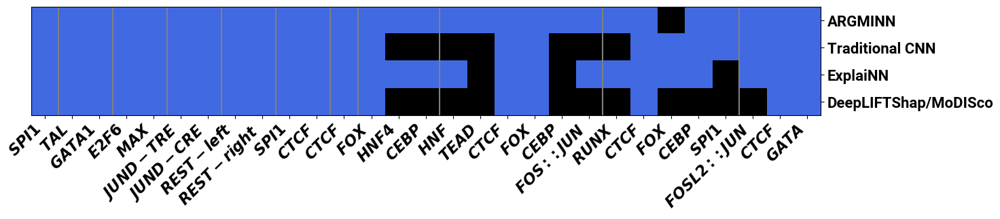

In [28]:
# Plot relevant motifs found as binary map
fig, ax = plt.subplots(figsize=(15, 3))

match_ind_matrix = np.stack([
    np.array(sum([[tup[2] for tup in rel_motif_counts[dataset_key]] for dataset_key in datasets], [])) > 0,
    np.array(sum([[tup[3] for tup in rel_motif_counts[dataset_key]] for dataset_key in datasets], [])) > 0,
    np.array(sum([[tup[4] for tup in rel_motif_counts[dataset_key]] for dataset_key in datasets], [])) > 0,
    np.array(sum([[tup[5] for tup in rel_motif_counts[dataset_key]] for dataset_key in datasets], [])) > 0
], axis=1)

motif_labels = sum(
    [[
        "$" + tup[0].replace("_", "-") + ("_{RC}" if tup[1] else "") + "$" for tup in rel_motif_counts[dataset_key]
    ] for dataset_key in datasets],
    []
)
method_labels = ["ARGMINN", "Traditional CNN", "ExplaiNN", "DeepLIFTShap/MoDISco"]

cmap_colors = ["black", "royalblue"]
cmap = pcolors.ListedColormap(cmap_colors, N=2)

ax.imshow(np.transpose(match_ind_matrix), cmap=cmap, interpolation="none")

dataset_lens = [len(rel_motif_counts[dataset_key]) for dataset_key in datasets]
vline_locs = np.cumsum(dataset_lens)[:-1]
for loc in vline_locs:
    ax.axvline(loc - 0.5, color="gray")
ax.set_xticks(np.arange(len(match_ind_matrix)))
ax.set_xticklabels(motif_labels, rotation=45, ha="right")
ax.yaxis.tick_right()
ax.set_yticks(np.arange(len(method_labels)))
ax.set_yticklabels(method_labels)

plt.show()
os.makedirs(os.path.join(figures_out_path, "motif_similarities"), exist_ok=True)
fig.savefig(os.path.join(figures_out_path, "motif_similarities", "rel_motif_binary_indicators.svg"), format="svg")

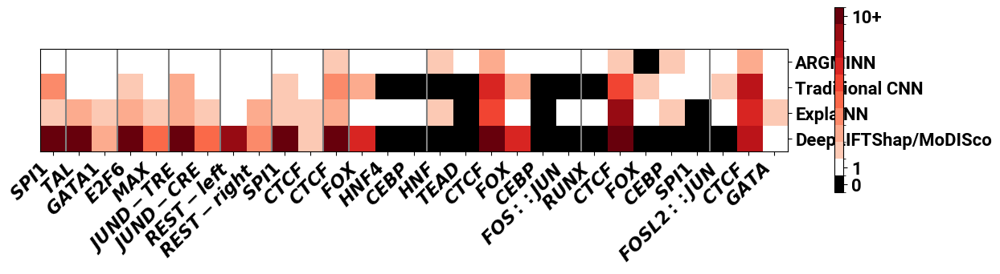

In [29]:
# Plot motif redundancy as heatmap
fig, ax = plt.subplots(figsize=(15, 3))

match_count_matrix = np.stack([
    np.array(sum([[tup[2] for tup in rel_motif_counts[dataset_key]] for dataset_key in datasets], [])),
    np.array(sum([[tup[3] for tup in rel_motif_counts[dataset_key]] for dataset_key in datasets], [])),
    np.array(sum([[tup[4] for tup in rel_motif_counts[dataset_key]] for dataset_key in datasets], [])),
    np.array(sum([[tup[5] for tup in rel_motif_counts[dataset_key]] for dataset_key in datasets], []))
], axis=1)

motif_labels = sum(
    [[
        "$" + tup[0].replace("_", "-") + ("_{RC}" if tup[1] else "") + "$" for tup in rel_motif_counts[dataset_key]
    ] for dataset_key in datasets],
    []
)
method_labels = ["ARGMINN", "Traditional CNN", "ExplaiNN", "DeepLIFTShap/MoDISco"]

cmap_max_count = 10
base_cmap = plt.colormaps["Reds"]
cmap_colors = ["black", "white"] + list(base_cmap(np.arange(2, cmap_max_count + 1) / cmap_max_count))
cmap = pcolors.ListedColormap(cmap_colors, N=(cmap_max_count + 1))
# Anything outside of `cmap_max_count` gets clipped to the max
cnorm = pcolors.Normalize(vmin=0, vmax=cmap_max_count, clip=True)

ax.imshow(np.transpose(match_count_matrix), cmap=cmap, interpolation="none", norm=cnorm)

dataset_lens = [len(rel_motif_counts[dataset_key]) for dataset_key in datasets]
vline_locs = np.cumsum(dataset_lens)[:-1]
for loc in vline_locs:
    ax.axvline(loc - 0.5, color="gray")
ax.set_xticks(np.arange(len(match_count_matrix)))
ax.set_xticklabels(motif_labels, rotation=45, ha="right")
ax.yaxis.tick_right()
ax.set_yticks(np.arange(len(method_labels)))
ax.set_yticklabels(method_labels)

boundaries = np.linspace(-0.5, cmap_max_count + 0.5, cmap_max_count + 2)
cnorm_bound = plt.cm.colors.BoundaryNorm(boundaries, cmap.N)
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=cnorm_bound, cmap=cmap), boundaries=boundaries, ticks=[0, 1, cmap_max_count], ax=plt.gca())
cbar.ax.set_yticklabels([0, 1, str(cmap_max_count) + "+"])

plt.show()
fig.savefig(os.path.join(figures_out_path, "motif_similarities", "rel_motif_redundancy.svg"), format="svg")

In [30]:
# Collate into data table
data = []
col_names = [
    "Dataset", "Relevant motif", "ARGMINN", "Traditional CNN", "ExplaiNN", "DeepLIFTShap/MoDISco"
]

for dataset_key in datasets:
    for tup in rel_motif_counts[dataset_key]:
        motif_name = tup[0].replace("_", "-")
        count_vals = tup[2:]
        row = [dataset_key, motif_name] + list(count_vals)
        data.append(row)

rel_motif_counts_table = pd.DataFrame(data, columns=col_names)
rel_motif_counts_table

,Dataset,Relevant motif,ARGMINN,Traditional CNN,ExplaiNN,DeepLIFTShap/MoDISco
0,SPI1,SPI1,1,4,2,17
1,TAL/GATA,TAL,1,1,3,10
2,TAL/GATA,GATA1,1,1,2,3
3,E2F6,E2F6,1,2,3,10
4,E2F6,MAX,1,1,2,5
5,JUND/TEAD,JUND-TRE,1,3,3,22
6,JUND/TEAD,JUND-CRE,1,1,2,5
7,REST,REST-left,1,1,1,9
8,REST,REST-right,1,1,3,4
9,SPI1/CTCF,SPI1,1,2,2,11


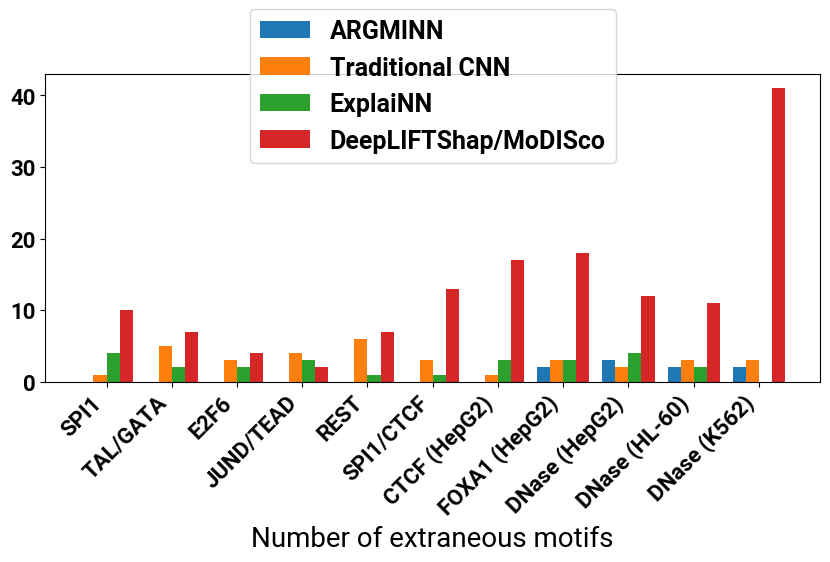

In [31]:
# Plot number of extraneous motifs found
fig, ax = plt.subplots(figsize=(10, 4))

num_bars = len(extra_motif_counts)
total_width = 0.8
num_bar_groups = 4
x = np.arange(num_bars)

bar_labels = list(extra_motif_counts.keys())
method_labels = ["ARGMINN", "Traditional CNN", "ExplaiNN", "DeepLIFTShap/MoDISco"]

bar_group_width = total_width / num_bar_groups
bar_width_offsets = -(total_width / 2) + \
    (total_width / num_bar_groups * np.arange(num_bar_groups)) + \
    (total_width / num_bar_groups / 2)

for i in range(num_bar_groups):
    ax.bar(
        x + bar_width_offsets[i],
        [extra_motif_counts[dataset_key][i] for dataset_key in datasets],
        bar_group_width, label=method_labels[i]
    )

ax.set_xticks(x)
ax.set_xticklabels(bar_labels, rotation=45, ha="right")
ax.set_xlabel("Number of extraneous motifs")
ax.legend(loc="upper center", bbox_to_anchor=(0.5, 1.25))
plt.show()
fig.savefig(os.path.join(figures_out_path, "motif_similarities", "extraneous_motifs.svg"), format="svg")

In [32]:
# Collate into data table
data = []
col_names = [
    "Dataset", "ARGMINN", "Traditional CNN", "ExplaiNN", "DeepLIFTShap/MoDISco"
]

for dataset_key in datasets:
    row = [dataset_key]
    row.extend(extra_motif_counts[dataset_key])
    data.append(row)

extra_motif_counts_table = pd.DataFrame(data, columns=col_names)
extra_motif_counts_table

,Dataset,ARGMINN,Traditional CNN,ExplaiNN,DeepLIFTShap/MoDISco
0,SPI1,0,1,4,10
1,TAL/GATA,0,5,2,7
2,E2F6,0,3,2,4
3,JUND/TEAD,0,4,3,2
4,REST,0,6,1,7
5,SPI1/CTCF,0,3,1,13
6,CTCF (HepG2),0,1,3,17
7,FOXA1 (HepG2),2,3,3,18
8,DNase (HepG2),3,2,4,12
9,DNase (HL-60),2,3,2,11


SPI1


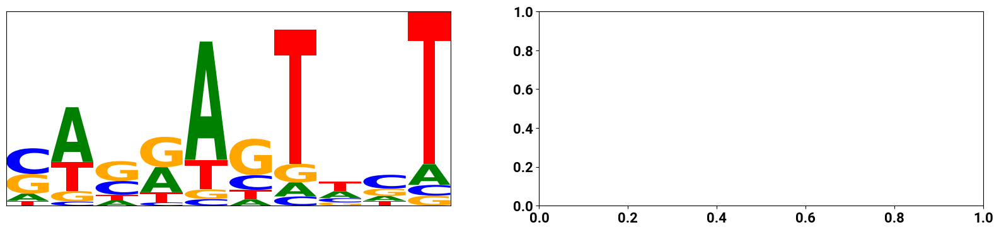

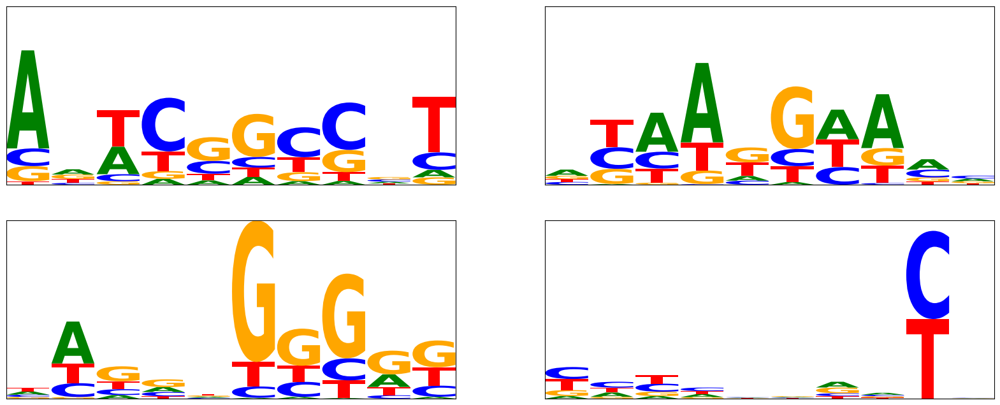

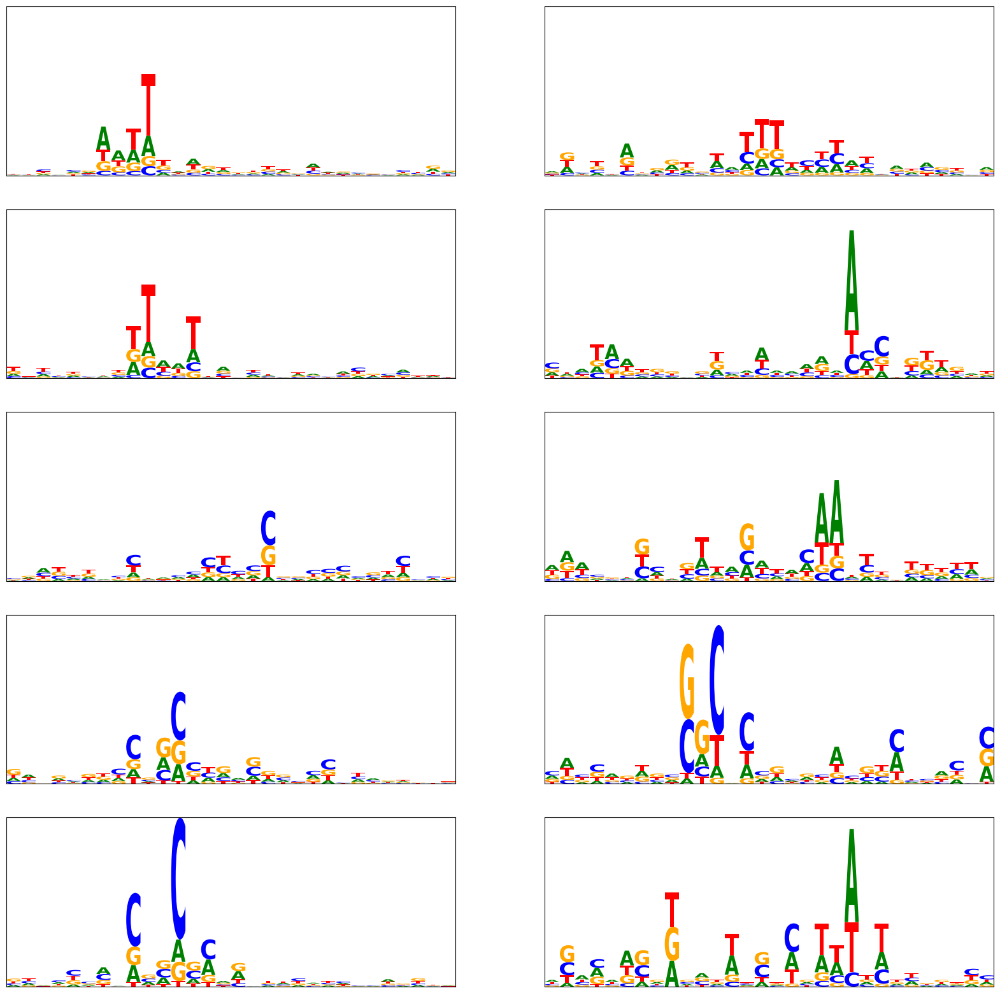

TAL/GATA


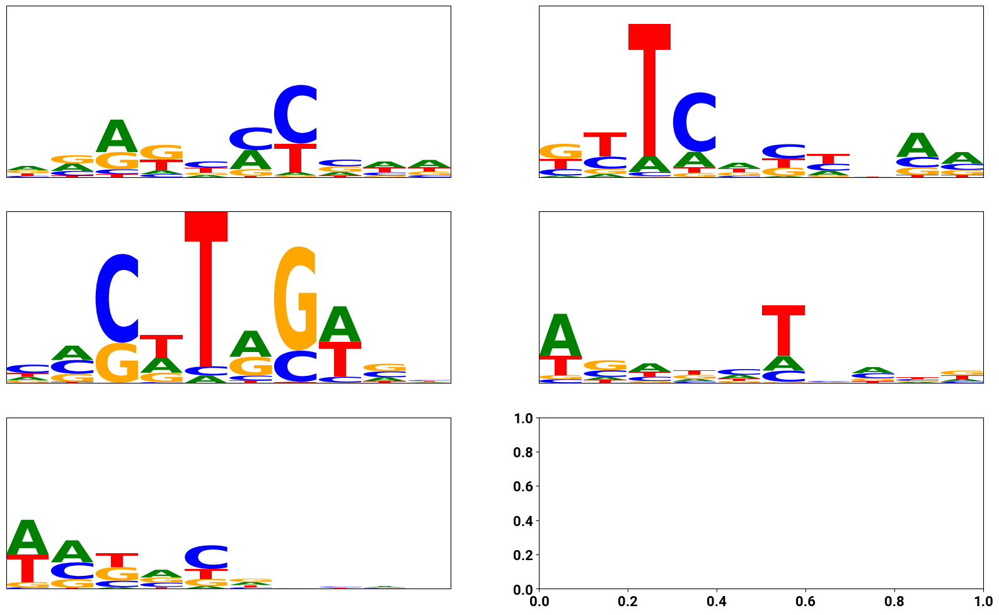

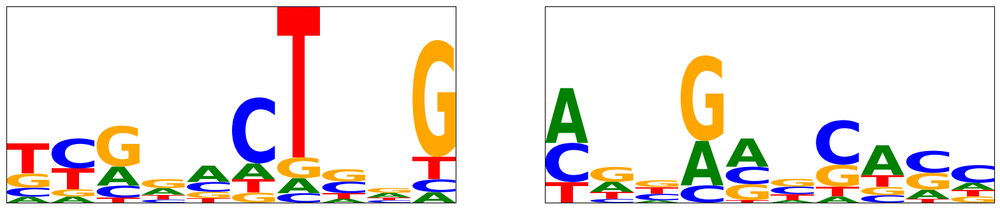

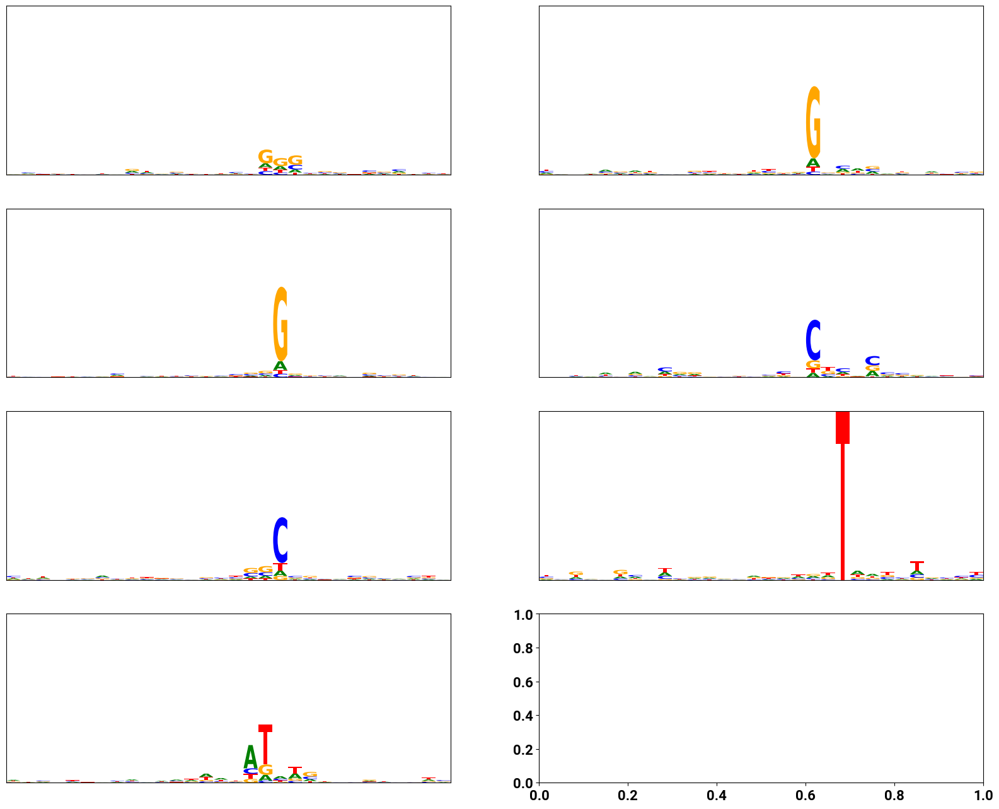

E2F6


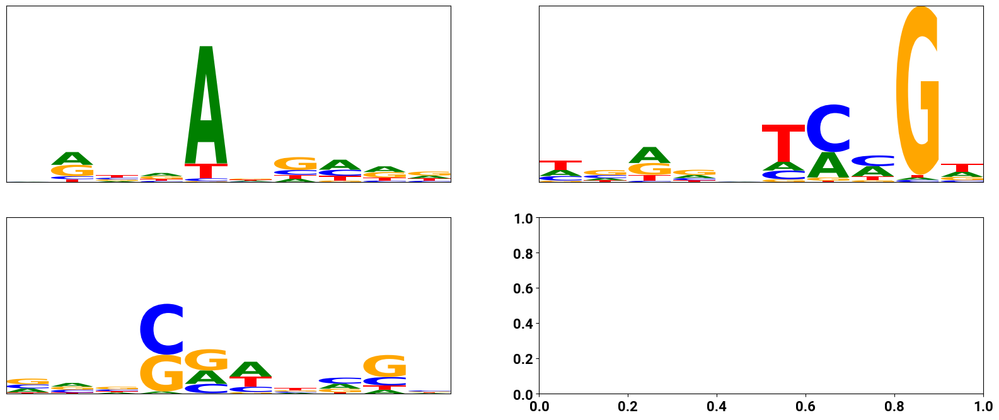

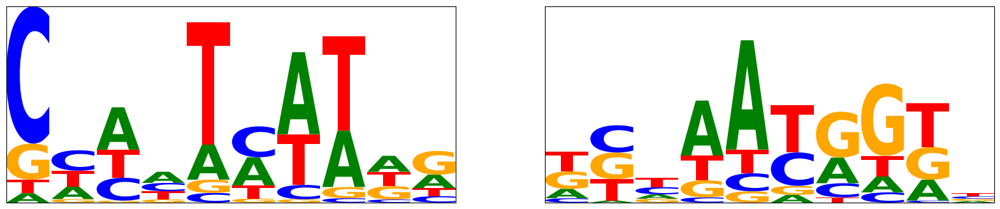

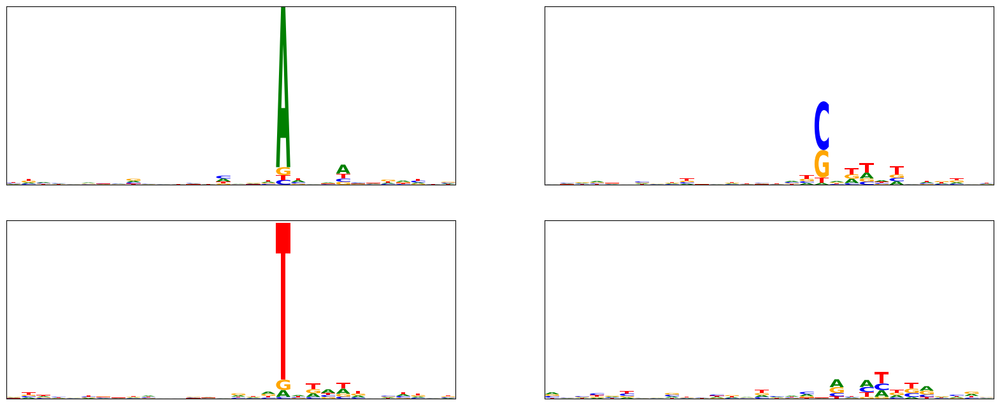

JUND/TEAD


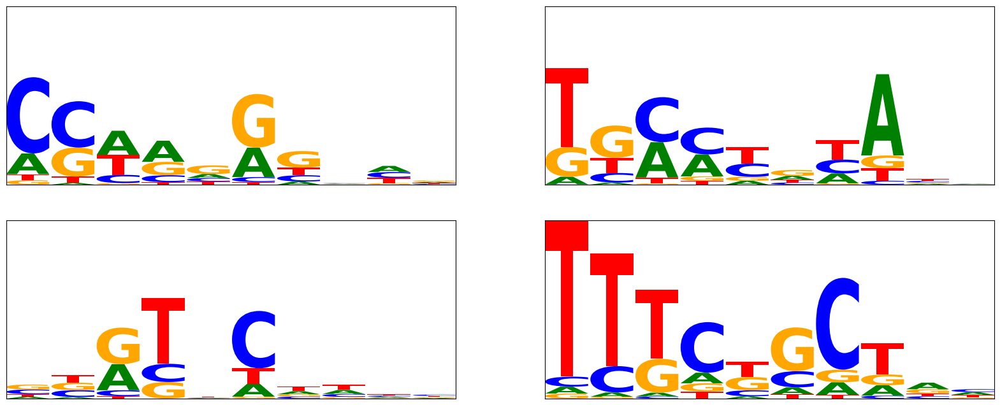

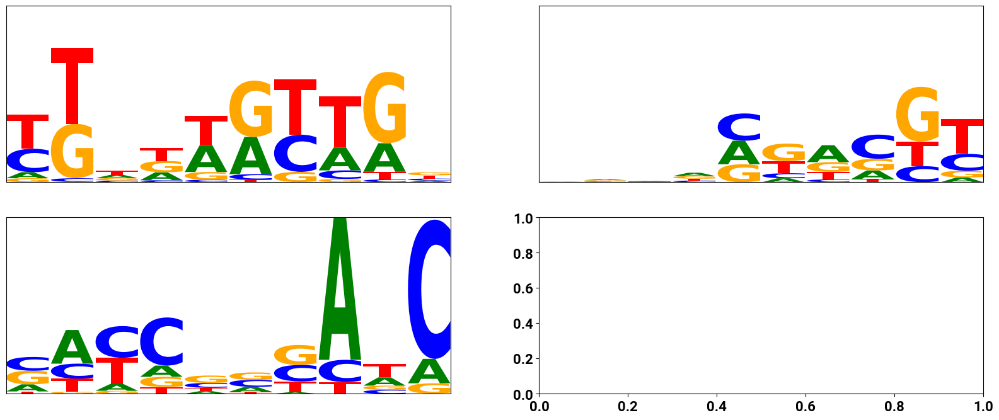

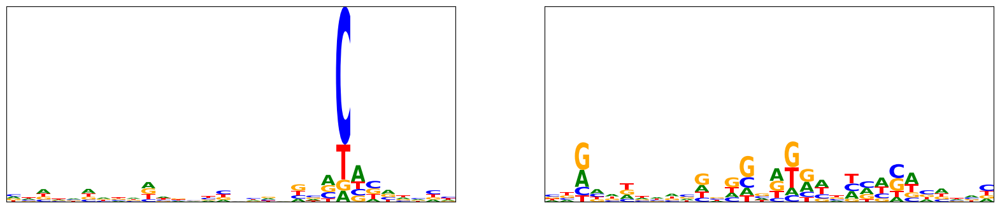

REST


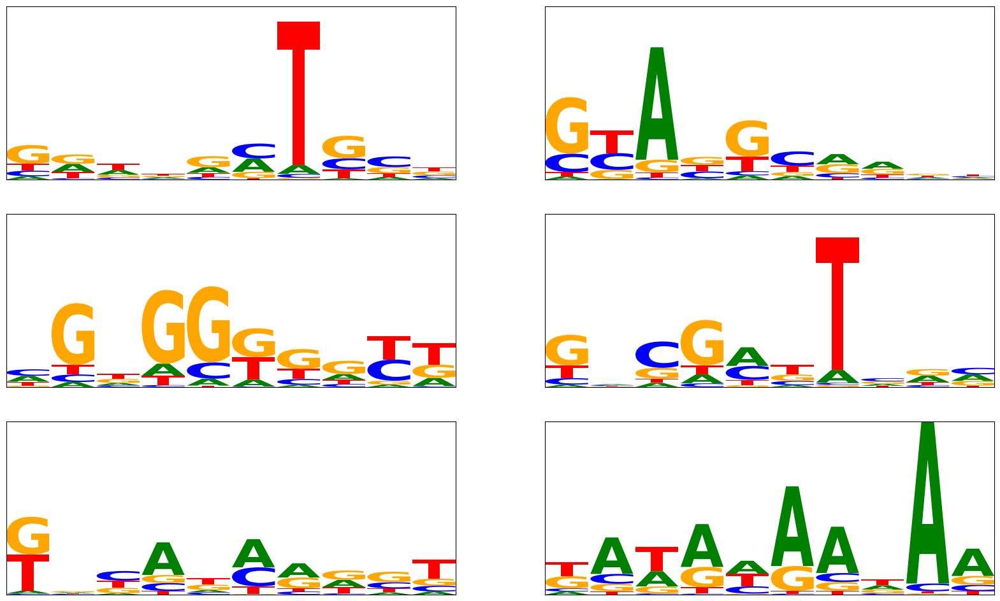

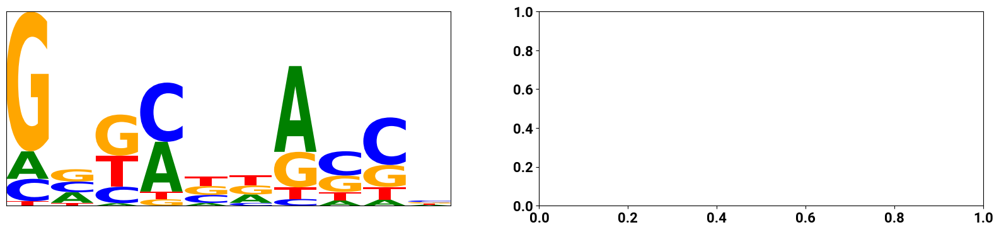

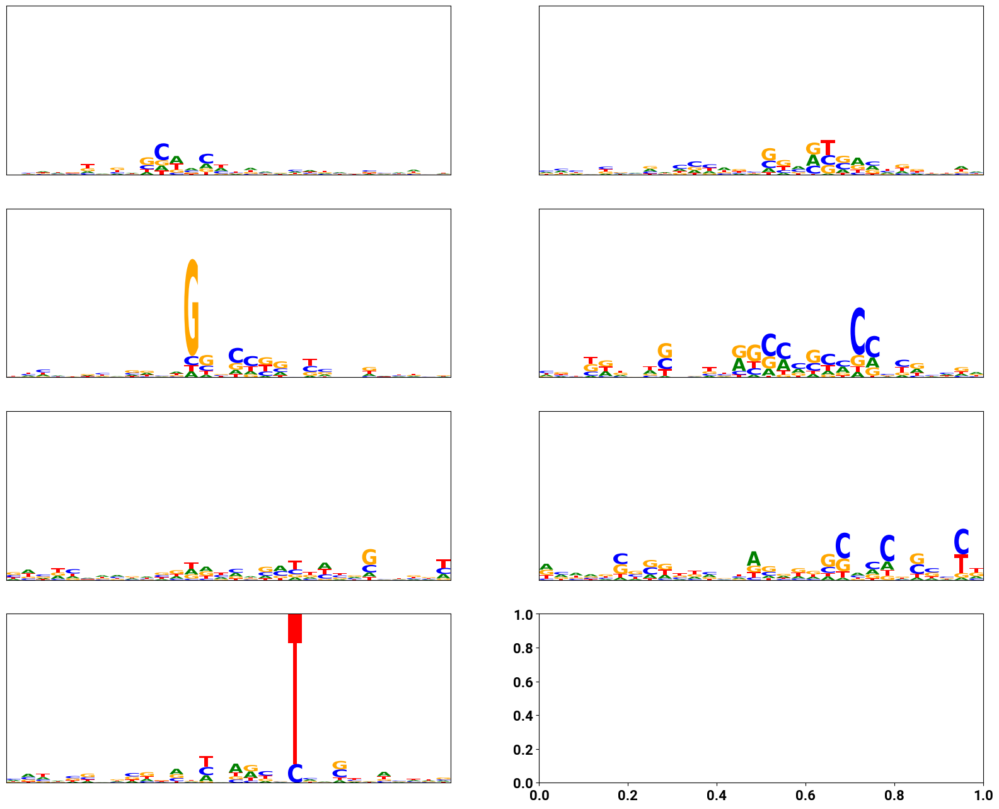

SPI1/CTCF


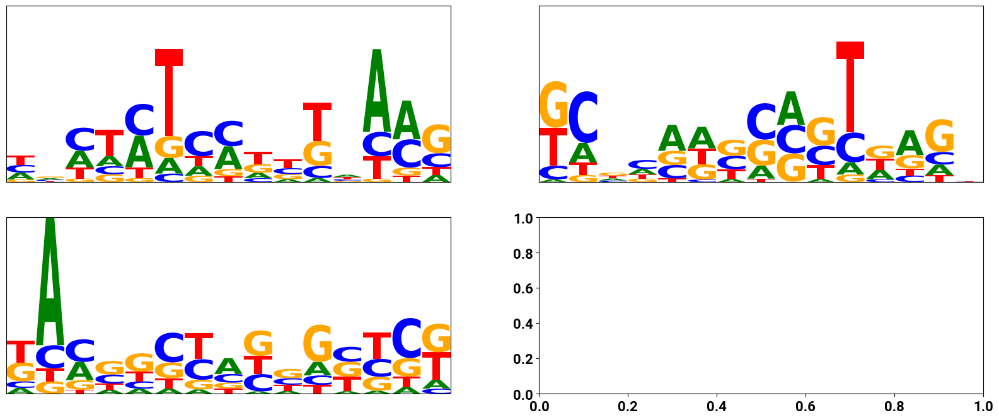

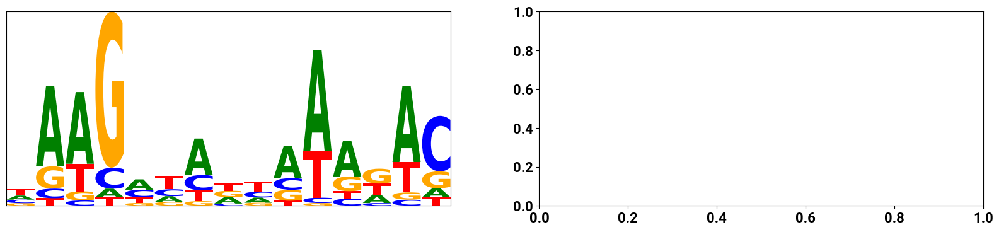

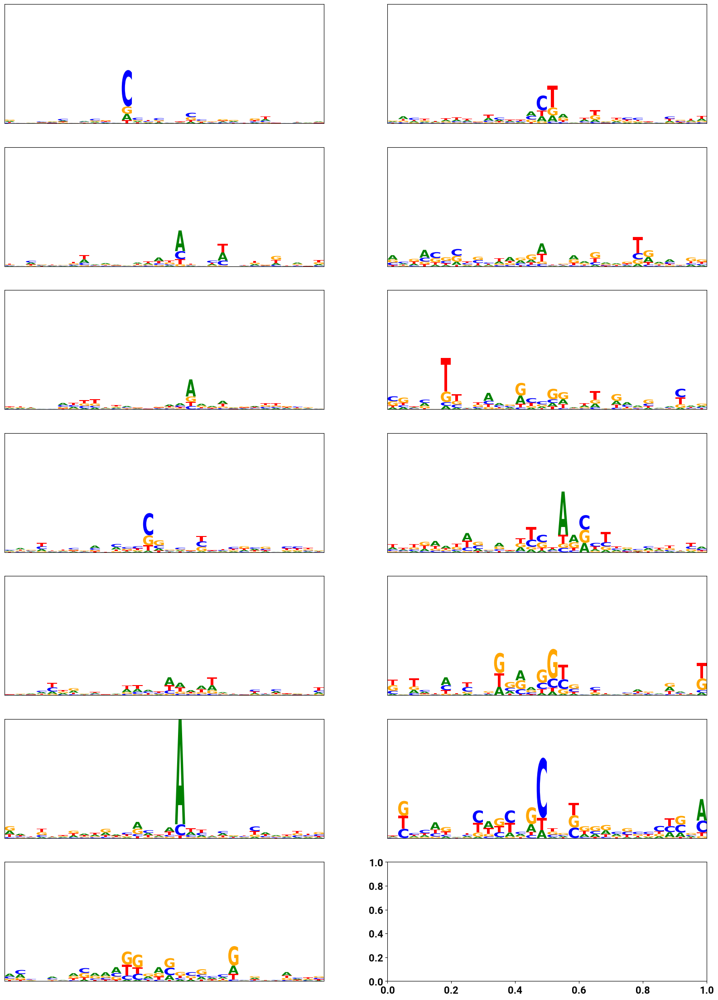

CTCF (HepG2)


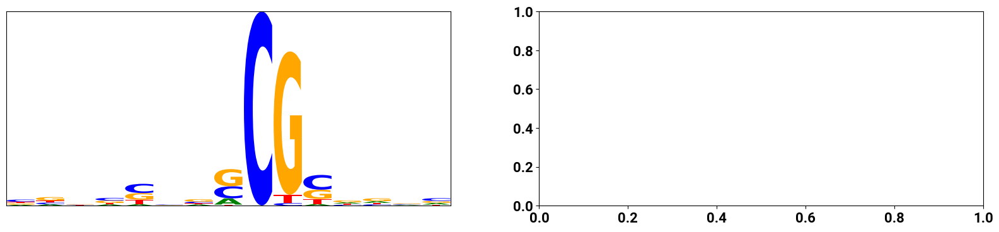

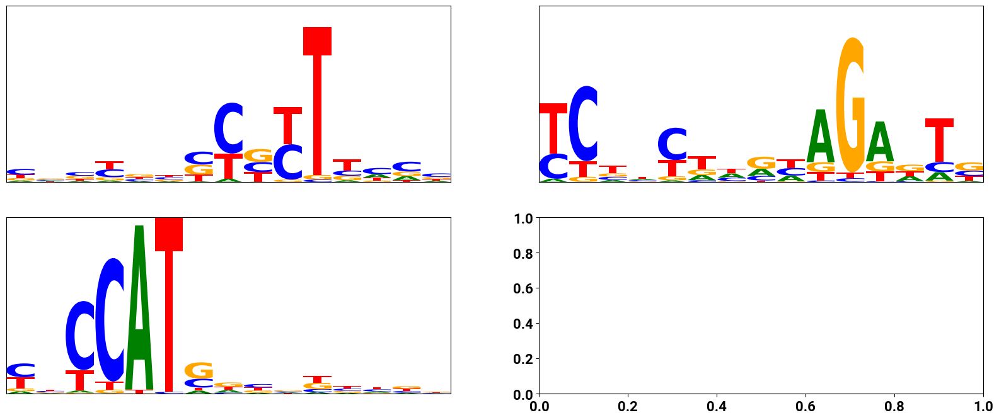

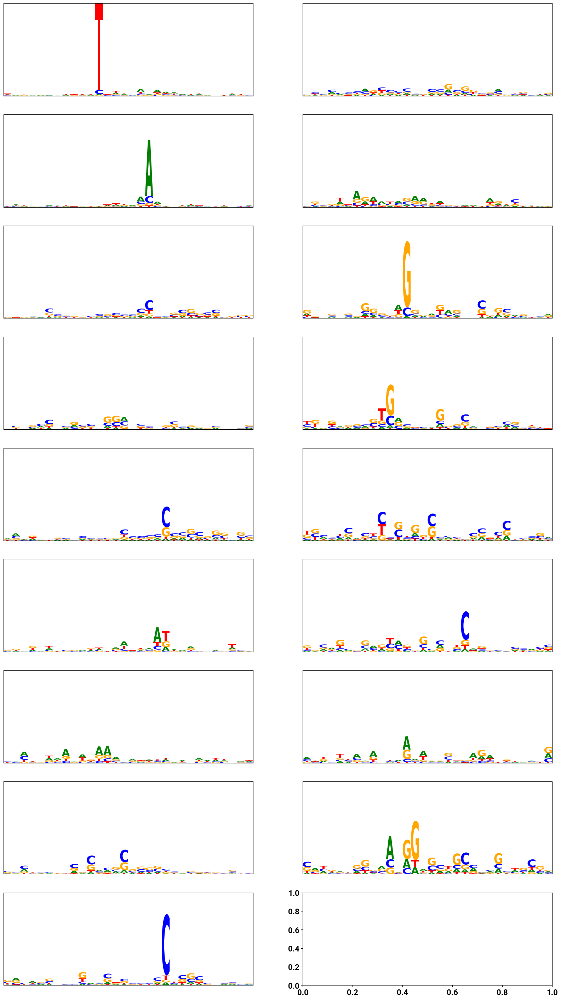

FOXA1 (HepG2)


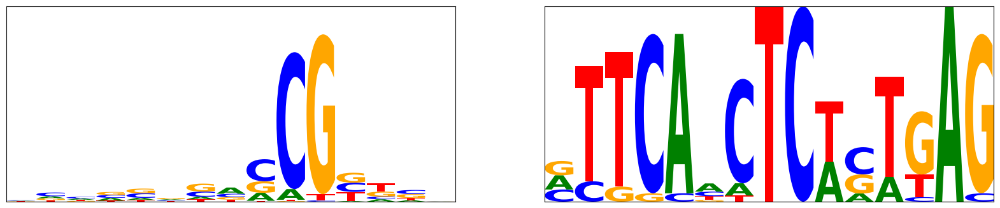

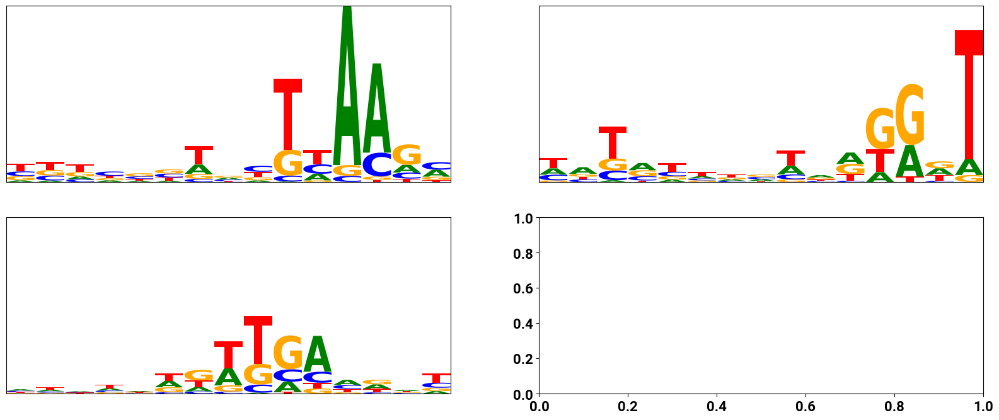

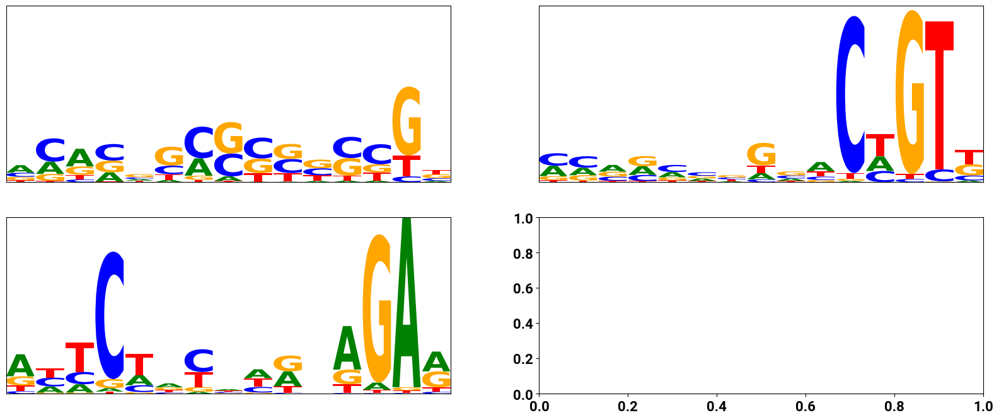

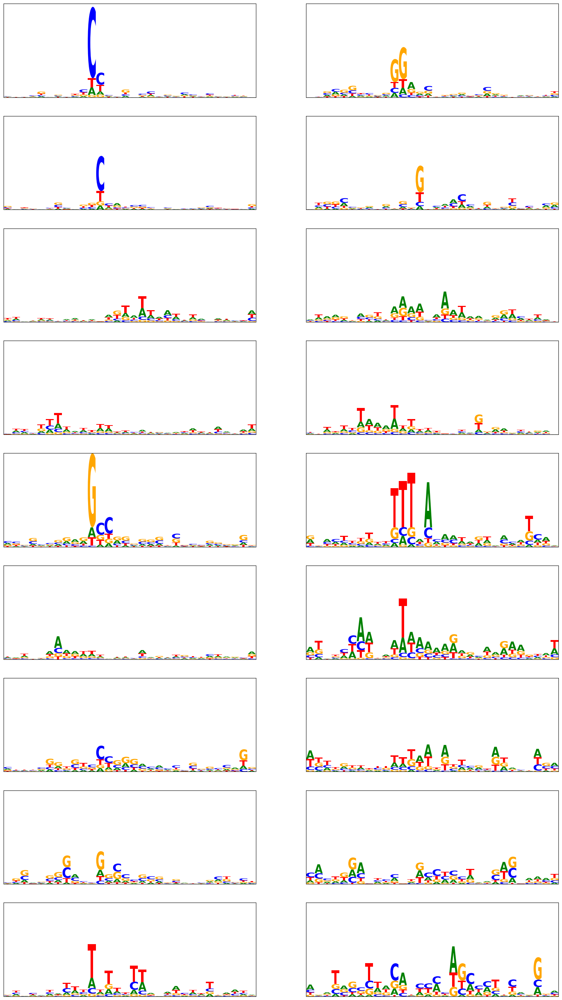

DNase (HepG2)


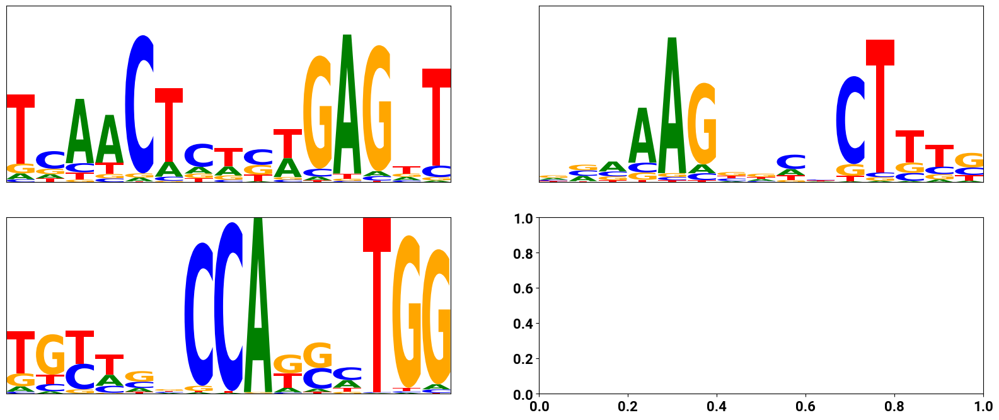

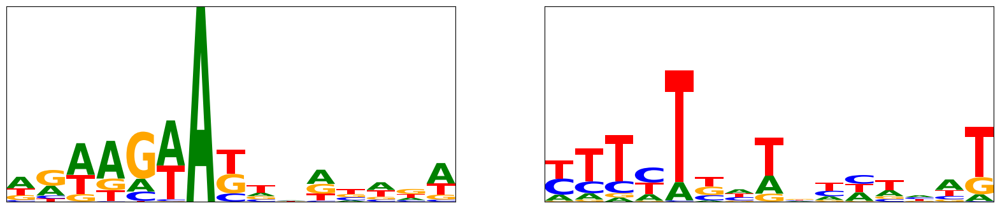

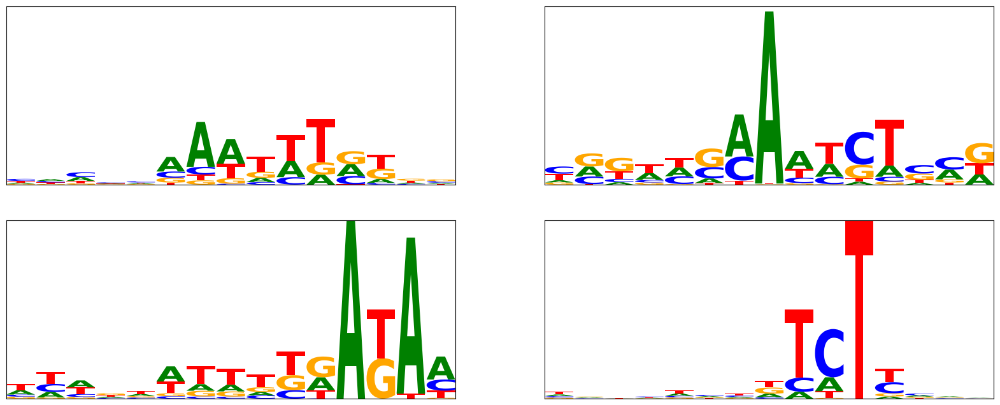

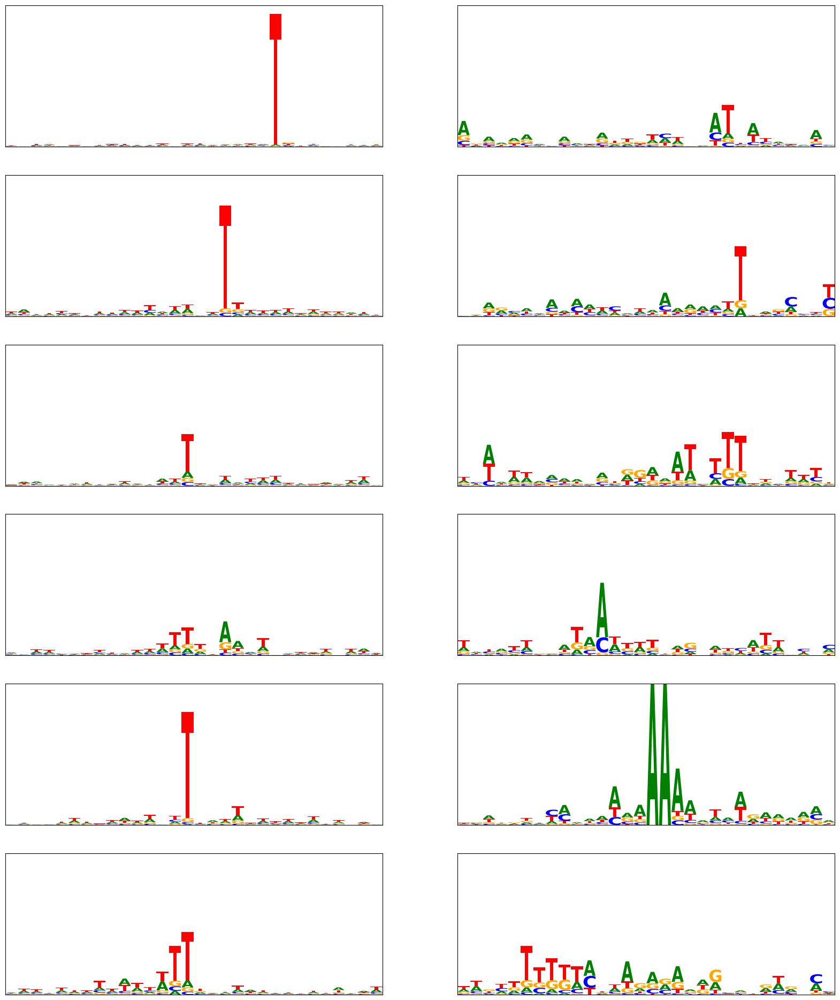

DNase (HL-60)


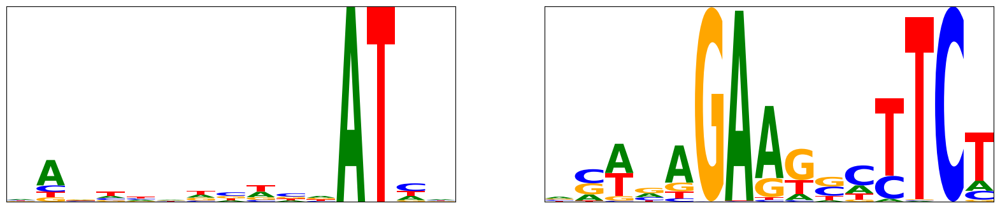

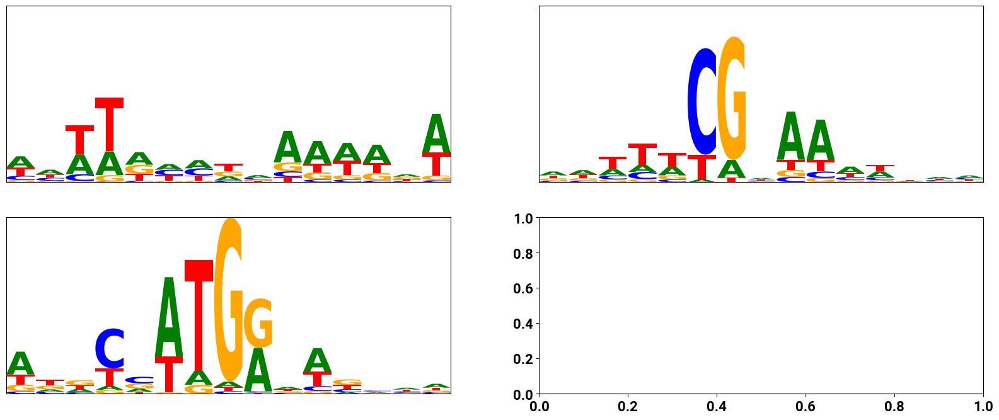

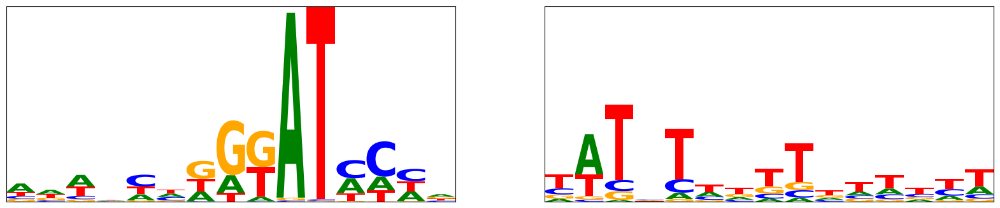

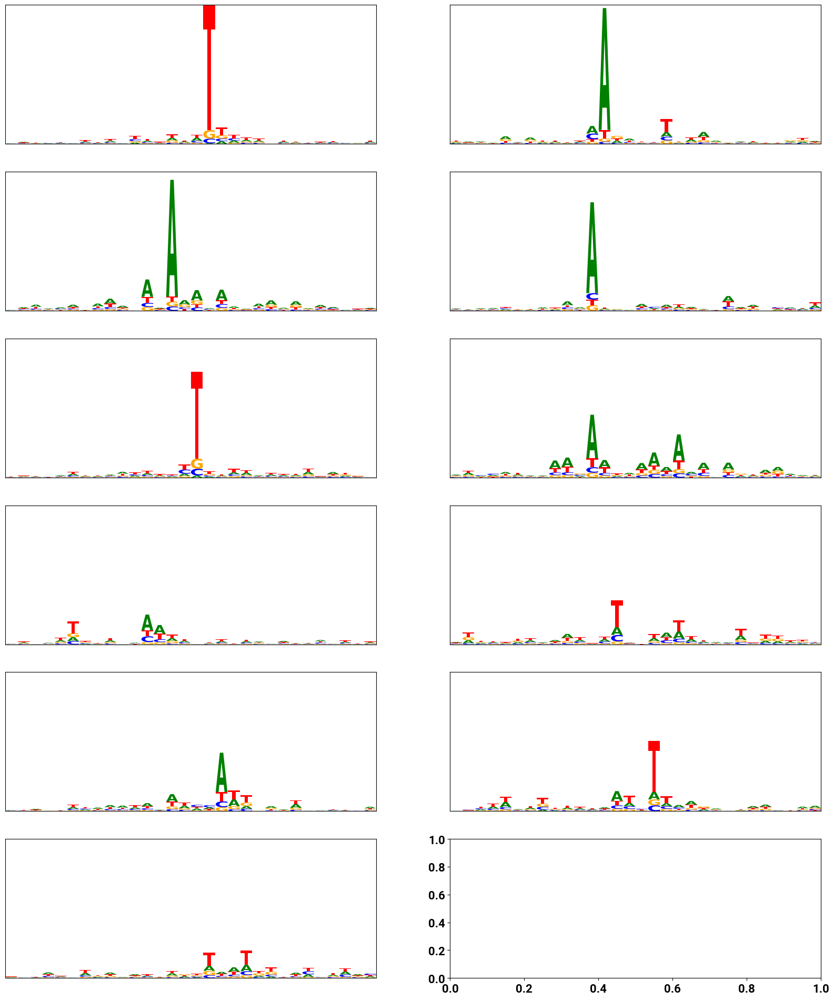

DNase (K562)


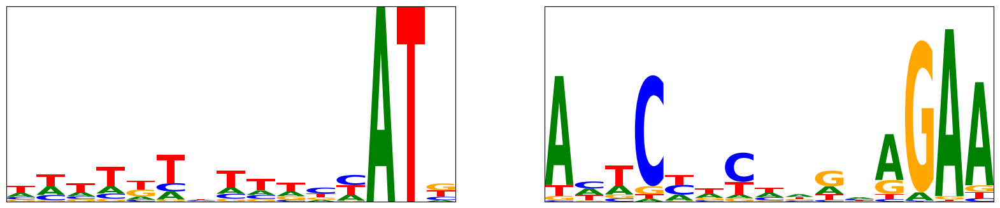

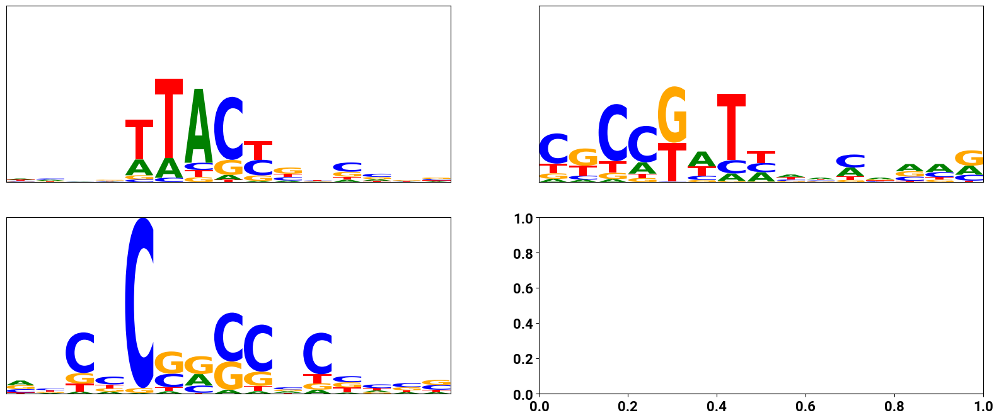

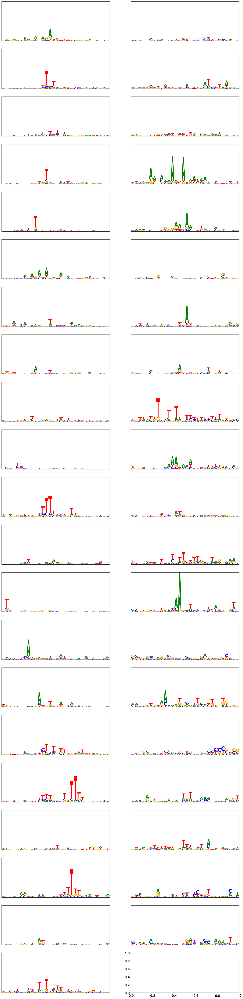

In [33]:
save_stem = os.path.join(figures_out_path, "extraneous_motifs")
os.makedirs(save_stem, exist_ok=True)
# Plot the extraneous motifs
for dataset_key in datasets:
    print(dataset_key)
    mechint_extras = [
        pfm * motif_util.pfm_info_content(pfm)[:, None] for i, pfm in enumerate(mechint_pfms[dataset_key])
        if mechint_rel_matches[dataset_key][i] is None and mechint_pfms_used[dataset_key][i]
    ]
    if mechint_extras:
        fig = plot_motifs.plot_motif_grid(mechint_extras, show_x=False, show_y=False)
        fig.savefig(os.path.join(save_stem, datasets_sanit[dataset_key] + "_mechint_extraneous_motifs.svg"), format="svg")
        
    cnn_extras = [
        pfm * motif_util.pfm_info_content(pfm)[:, None] for i, pfm in enumerate(cnn_pfms[dataset_key])
        if cnn_rel_matches[dataset_key][i] is None and cnn_pfms_used[dataset_key][i]
    ]
    if cnn_extras:
        fig = plot_motifs.plot_motif_grid(cnn_extras, show_x=False, show_y=False)
        fig.savefig(os.path.join(save_stem, datasets_sanit[dataset_key] + "_cnn_extraneous_motifs.svg"), format="svg")

    explainn_extras = [
        pfm * motif_util.pfm_info_content(pfm)[:, None] for i, pfm in enumerate(explainn_pfms[dataset_key])
        if explainn_rel_matches[dataset_key][i] is None and explainn_pfms_used[dataset_key][i]
    ]
    if explainn_extras:
        fig = plot_motifs.plot_motif_grid(explainn_extras, show_x=False, show_y=False)
        fig.savefig(os.path.join(save_stem, datasets_sanit[dataset_key] + "_explainn_extraneous_motifs.svg"), format="svg")

    modisco_extras = [
        pfm * motif_util.pfm_info_content(pfm)[:, None] for i, pfm in enumerate(modisco_pfms[dataset_key])
        if modisco_rel_matches[dataset_key][i] is None
    ]
    if modisco_extras:
        fig = plot_motifs.plot_motif_grid(modisco_extras, show_x=False, show_y=False)
        fig.savefig(os.path.join(save_stem, datasets_sanit[dataset_key] + "_modisco_extraneous_motifs.svg"), format="svg")
    plt.show()

In [34]:
# Compute similarity of each relevant motif to matched discovered motifs
agg_func = np.max

# Aggregate similarity values of the discovered motifs which match a given relevant motif key
# Ignore orientation if it is None
matches_to_agg_val = lambda matches, motif_key, orientation: agg_func([
    match[2] if (match and (motif_key.upper() in match[0].upper()) and (orientation is None or match[1] == orientation)) else 0
    for match in matches
])

rel_motif_sims = {}
for dataset_key in datasets:
    motif_keys = relevant_motifs[dataset_key]
    rel_motif_sims[dataset_key] = []
    for motif_key in motif_keys:
        combine_rc = motif_key.endswith("*")
        motif_key = motif_key[:-1] if combine_rc else motif_key
        orientations = (None,) if combine_rc else (False, True)

        # For non-RC-symmetric relevant motifs, add an entry for each orientation
        # For RC-symmetric relevant motifs, combine across orientations
        new_entries = []
        for orientation in orientations:
            mechint_val = matches_to_agg_val(mechint_rel_matches[dataset_key], motif_key, orientation)
            cnn_val = matches_to_agg_val(cnn_rel_matches[dataset_key], motif_key, orientation)
            explainn_val = matches_to_agg_val(explainn_rel_matches[dataset_key], motif_key, orientation)
            modisco_val = matches_to_agg_val(modisco_rel_matches[dataset_key], motif_key, orientation)

            new_entries.append((motif_key, orientation, mechint_val, cnn_val, explainn_val, modisco_val))

        # MoDISco motifs only come in one orientation, so take the maximum of all orientations
        max_modisco_val = max(tup[5] for tup in new_entries)
        new_entries = [tup[:5] + (max_modisco_val,) for tup in new_entries]
        
        rel_motif_sims[dataset_key].extend(new_entries)

In [35]:
# Combine forward and reverse orientations for plotting (can be skipped to keep separate)
for dataset_key in datasets:
    motif_keys, max_sims = [], {}
    for row in rel_motif_sims[dataset_key]:
        motif_key, orientation, sims = row[0], row[1], row[2:]
        
        if motif_key not in max_sims:
            motif_keys.append(motif_key)
            max_sims[motif_key] = sims
        else:
            assert len(max_sims[motif_key]) == len(sims)
            # Take maximum over orientations
            max_sims[motif_key] = [max(max_sims[motif_key][i], sims[i]) for i in range(len(sims))]
    rel_motif_sims[dataset_key] = [(motif_key, None) + tuple(max_sims[motif_key]) for motif_key in motif_keys]

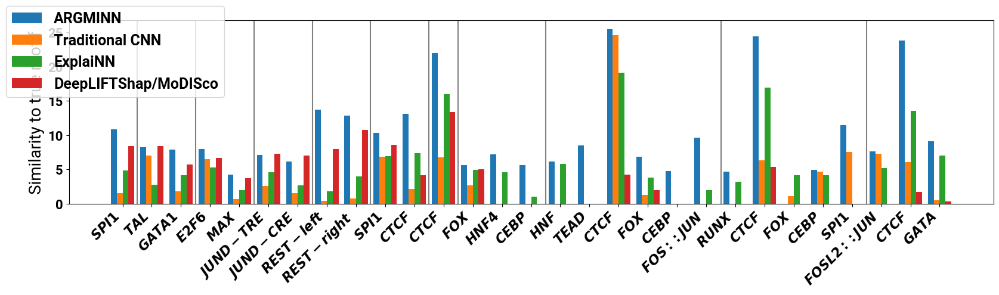

In [36]:
# Plot similarity of each relevant motif to matched discovered motifs
fig, ax = plt.subplots(figsize=(20, 4))

num_bars = sum(len(v) for v in rel_motif_sims.values())
total_width = 0.8
num_bar_groups = 4
x = np.arange(num_bars)

bar_labels = sum(
    [[
        "$" + tup[0].replace("_", "-") + ("_{RC}" if tup[1] else "") + "$" for tup in rel_motif_counts[dataset_key]
    ] for dataset_key in datasets],
    []
)
method_labels = ["ARGMINN", "Traditional CNN", "ExplaiNN", "DeepLIFTShap/MoDISco"]

bar_group_width = total_width / num_bar_groups
bar_width_offsets = -(total_width / 2) + \
    (total_width / num_bar_groups * np.arange(num_bar_groups)) + \
    (total_width / num_bar_groups / 2)

for i in range(num_bar_groups):
    ax.bar(
        x + bar_width_offsets[i],
        sum([[tup[2 + i] for tup in rel_motif_sims[dataset_key]] for dataset_key in datasets], []),
        bar_group_width, label=method_labels[i]
    )

dataset_lens = [len(rel_motif_sims[dataset_key]) for dataset_key in datasets]
vline_locs = np.cumsum(dataset_lens)[:-1]
for loc in vline_locs:
    ax.axvline(loc - 0.5, color="gray")
ax.set_xticks(x)
ax.set_xticklabels(bar_labels, rotation=45, ha="right")
ax.set_ylabel("Similarity to true motif")
ax.legend(loc="upper center", bbox_to_anchor=(0.05, 1.12))
plt.show()
fig.savefig(os.path.join(figures_out_path, "motif_similarities", "rel_motif_similarities.svg"), format="svg")

In [37]:
# Collate into data table
data = []
col_names = [
    "Dataset", "Relevant motif", "ARGMINN", "Traditional CNN", "ExplaiNN", "DeepLIFTShap/MoDISco"
]

for dataset_key in datasets:
    for tup in rel_motif_sims[dataset_key]:
        motif_name = tup[0].replace("_", "-")
        sim_vals = tup[2:]
        row = [dataset_key, motif_name] + list(sim_vals)
        data.append(row)

rel_motif_sims_table = pd.DataFrame(data, columns=col_names)
rel_motif_sims_table

,Dataset,Relevant motif,ARGMINN,Traditional CNN,ExplaiNN,DeepLIFTShap/MoDISco
0,SPI1,SPI1,10.889727,1.582806,4.875851,8.451976
1,TAL/GATA,TAL,8.262670,7.016693,2.768742,8.395276
2,TAL/GATA,GATA1,7.914171,1.813030,4.139569,5.737070
3,E2F6,E2F6,8.030722,6.547135,5.334963,6.699157
4,E2F6,MAX,4.288779,0.713366,1.969081,3.705527
5,JUND/TEAD,JUND-TRE,7.163527,2.616016,4.583817,7.298189
6,JUND/TEAD,JUND-CRE,6.149604,1.544134,2.666847,7.073782
7,REST,REST-left,13.727344,0.428005,1.783480,8.027307
8,REST,REST-right,12.894834,0.742182,3.990902,10.738775
9,SPI1/CTCF,SPI1,10.339296,6.894003,6.938073,8.578149
